In [1]:
import os
from itertools import product

import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
from matplotlib import gridspec

import pandas as pd
from pingouin import mixed_anova, anova, pairwise_tukey, pairwise_ttests
import pingouin as pg
from statsmodels.regression.mixed_linear_model import MixedLM

import TwoPUtils as tpu
import STX3KO_analyses as stx
from STX3KO_analyses import utilities as u



plt.rcParams['pdf.fonttype']=42
ko_mice = stx.ymaze_sess_deets.ko_mice

ctrl_mice = stx.ymaze_sess_deets.ctrl_mice
# ctrl_mice = [m for m in ctrl_mice if m not in ('mCherry6')]

%matplotlib inline

%load_ext autoreload
%autoreload 2

/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


1) Find some examples of reactivation in both groups for novel and familiar

2) Show no difference in proportion of cells recruited to reactivation

    a) in novel or familiar
    
    b) in familiar when restricting to last block

3) Show that reactivated cells tend to have higher firing rates than non reactivated cells in novel environments

    a) show that reactivated cells also distinguish between novel and familiar environments by firing rate
    
    b) make sure to exclude post reward reactivation in calculation
    
    
4) Show higher trial x trial correlation in reactivated vs non-reactivated cells

    a) only in novel and effect bigger in controls
    
    b) find some examples 
    
    c) exclude reward consumption times/cells who's peak is within the reward zone/spatial bins within the reward zone
    
    
5) Show higher across day correlation for cells that are reactivated vs non-reactivated

    a) effect present in both familiar and novel
    
    b) effect bigger in controls 
    
    c) exclude reward consumption times/cells who's peak is within the reward zone/spatial bins within the reward zone
    
    d) find examples 
    
    
6) Find all cells reactivated during reward consumption

    a) plot their activity during a reactivation event
    
    b) are they highly synchronous
    
    c) sort cells by their location of peak firing during running
    
    

    

In [2]:
# look at cells that are reactivated in novel environment
# do these cells go on to be place cells? do they discriminate between familiar and novel environments more
# what about in familiar? 
# across days

In [5]:
class RewardReactivation:
    
    def __init__(self, sess):
        
        if isinstance(sess.scan_info,list):
            self.frame_rate = sess.scan_info[0]['frame_rate']
        else:
            self.frame_rate = sess.scan_info['frame_rate']
        
        
        
        
        self.spks = sess.timeseries['spks']
        self.trial_mat = sess.trial_matrices['spks_norm']
        self.speed = sess.timeseries['speed']
        self.lr = sess.timeseries['LR'].ravel()
        self.t = sess.timeseries['t'].ravel()
        self.reward = sess.timeseries['reward'].ravel()
        self.block_number = sess.timeseries['block_number'].ravel()
        
        self.novel_arm = sess.novel_arm
        self.trial_info = sess.trial_info
        self.trial_start_inds = sess.trial_start_inds
        self.teleport_inds = sess.teleport_inds
        
        
        # mask for post reward epochs
        self.post_reward_epochs = None
        self._post_reward_mask(sess)
        
        # threshold spks timeseries to get "significant" transients
        self.thresh_spks = .2*np.nanmax(sess.timeseries['spks'], axis=-1, keepdims=True)
        self.spks_th = 1.*np.copy(self.spks)
        self.spks_th[self.spks<self.thresh_spks]=0
        
        
        
        # all activations during stopping, including periods when not near reward zone
        self.activation_mask = None
        # activations during reward consumption
        self.post_reward_activation_mask = None
        # all activations during running
        self.trial_activation_mask = None
        self.get_activations()
        
        boxcar = np.ones([1,8]) # 500 ms window
        self.post_reward_activation_boxcar = sp.signal.convolve(self.post_reward_activation_mask,boxcar,mode='same')
        self.pop_coactivity_boxcar = self.post_reward_activation_boxcar.sum(axis=0)
        
        # active during trial and during reward consumption
        self.post_reward_reactivation_mask = None
        # active during trial but not during reward consumption
        self.non_reactivation_mask = None
        self.get_post_reward_reactivations()
        
        
    def _post_reward_mask(self, sess, max_post_reward_time = 5, max_post_reward_dist = 3):
        post_reward_bool = 0.*self.t.ravel()
        for start,stop in zip(self.trial_start_inds, self.teleport_inds):

            cum_reward = np.cumsum(self.reward.ravel()[start:stop])>0
            post_reward_inds = np.argwhere(cum_reward).ravel()
            if post_reward_inds.shape[0]>0:
                post_reward_bool[post_reward_inds[0]+start:start+np.minimum(post_reward_inds[0]+int(max_post_reward_time*self.frame_rate),stop-start)] = 1


        nov_post_rzone_mask = (sess.timeseries['LR']==sess.novel_arm)*(sess.timeseries['t']>sess.rzone_nov['tfront']+max_post_reward_dist)
        fam_post_rzone_mask = (sess.timeseries['LR']==-1*sess.novel_arm)*(sess.timeseries['t']>sess.rzone_fam['tfront']+max_post_reward_dist)
        post_reward_bool[nov_post_rzone_mask.ravel()]=0
        post_reward_bool[fam_post_rzone_mask.ravel()]=0
        self.post_reward_epochs = post_reward_bool
        
        
    def get_activations(self):
    
        spks_ledge = 1*(np.diff(1.*(self.spks_th>0),prepend=0,axis=-1)>0)

        self.activation_mask = 1*(spks_ledge>0)*(self.speed<2)
        self.post_reward_activation_mask = 1*(spks_ledge>0)*(self.speed<2)*(self.post_reward_epochs[np.newaxis,:])
        self.trial_activation_mask = 1*(spks_ledge>0)*(1-self.post_reward_epochs[np.newaxis,:])
    
    def get_post_reward_reactivations(self):
        post_reward_reactivation_mask = np.zeros((self.spks.shape[0],self.trial_start_inds.shape[0]))
        non_reactivation_mask = np.zeros((self.spks.shape[0],self.trial_start_inds.shape[0]))
        for trial, (start,stop) in enumerate(zip(self.trial_start_inds,self.teleport_inds)):
            post_reward_reactivation_mask[:,trial] = 1*(self.post_reward_activation_mask[:,start:stop].sum(axis=-1)>0)*(self.trial_activation_mask[:,start:stop].sum(axis=-1)>0)
            non_reactivation_mask[:,trial] = 1*(self.post_reward_activation_mask[:,start:stop].sum(axis=-1)==0)*(self.trial_activation_mask[:,start:stop].sum(axis=-1)>0)
        
        self.post_reward_reactivation_mask = post_reward_reactivation_mask
        self.non_reactivation_mask = non_reactivation_mask
        
    

        

### Make session files

In [7]:
import pickle

rr_dict = {}
basedir = '/home/mplitt/YMazeRewardReactPkls/'
for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    rr_dict[cond_key] = {}
    for day in range(6):
        rr_dict[cond_key][day] = {}
        for mouse in mice:
            print(mouse,day)
            rr = RewardReactivation(u.load_single_day(mouse,day,verbose=False))
            filename = basedir + f'{mouse}_day{day}.pkl'
            with open(filename, 'wb') as file:
                pickle.dump(rr,file)
                
            rr_dict[cond_key][day][mouse]=filename
                                                               

4467331.1 0
4467331.2 0
4467332.1 0
4467332.2 0
4467333.1 0
mCherry6 0
mCherry7 0
mCherry8 0
mCherry9 0
4467331.1 1
4467331.2 1
4467332.1 1
4467332.2 1
30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
4467333.1 1
mCherry6 1
mCherry7 1
mCherry8 1
mCherry9 1
4467331.1 2
4467331.2 2
4467332.1 2
4467332.2 2
4467333.1 2
mCherry6 2
mCherry7 2
mCherry8 2
mCherry9 2
4467331.1 3
4467331.2 3
02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
4467332.1 3
4467332.2 3
4467333.1 3
mCherry6 3
mCherry7 3
mCherry8 3
mCherry9 3
4467331.1 4
4467331.2 4
4467332.1 4
4467332.2 4
4467333.1 4
mCherry6 4
mCherry7 4
mCherry8 4
mCherry9 4
4467331.1 5
4467331.2 5
4467332.1 5
4467332.2 5
4467333.1 5


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


mCherry6 5
mCherry7 5
mCherry8 5
mCherry9 5
4467975.1 0
4467975.2 0
4467975.3 0
4467975.4 0
4467975.5 0
Cre7 0
Cre9 0
4467975.1 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.2 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.3 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.4 1
4467975.5 1
Cre7 1
Cre9 1
4467975.1 2


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.2 2


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.3 2


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.4 2
4467975.5 2
Cre7 2
Cre9 2
4467975.1 3
4467975.2 3


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.3 3
4467975.4 3
4467975.5 3
Cre7 3
Cre9 3
4467975.1 4
4467975.2 4


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.3 4
4467975.4 4
4467975.5 4
Cre7 4
Cre9 4
4467975.1 5
4467975.2 5


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


4467975.3 5
4467975.4 5
4467975.5 5
Cre7 5
Cre9 5


In [4]:
# cond, mouse, day = 'cre', ko_mice[6], 0
import pickle

rr_dict = {}
basedir = '/home/mplitt/YMazeRewardReactPkls/'
for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    rr_dict[cond_key] = {}
    for day in range(6):
        rr_dict[cond_key][day] = {}
        for mouse in mice:
            filename = basedir + f'{mouse}_day{day}.pkl'
            rr_dict[cond_key][day][mouse]=filename



    


### Plot some examples

In [11]:
cond, mouse, day = 'ctrl', ctrl_mice[1], 5
# cond, mouse, day = 'cre', ko_mice[6], 4
with open(rr_dict[cond][day][mouse], 'rb') as file:
    rr = pickle.load(file)

In [12]:
rr.post_reward_epochs.shape

(26724,)

0.517464424320828
(982, 26724) (982, 26724)


Text(0.5, 0, 'proportion coactive cells')

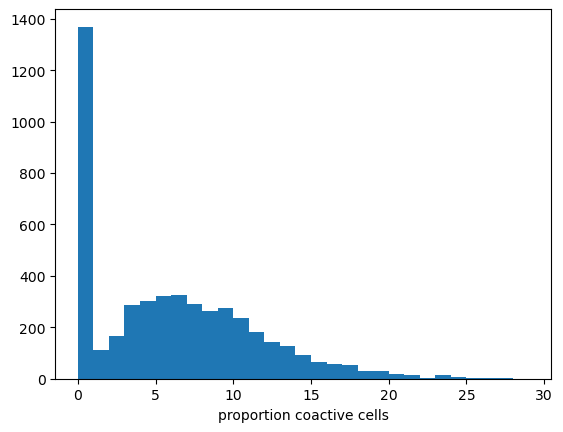

In [13]:
print(8/15.46)
fig,ax = plt.subplots()
boxcar = np.ones([1,4])
post_rew_act_bc = sp.signal.convolve(rr.post_reward_activation_mask,boxcar,mode='same')
print(post_rew_act_bc.shape, rr.post_reward_activation_mask.shape)
pop_coactivity = post_rew_act_bc.sum(axis=0)
ax.hist(pop_coactivity[rr.post_reward_epochs>0],np.arange(0,30))
ax.set_xlabel('proportion coactive cells')



/tmp/ipykernel_2282995/2853399837.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


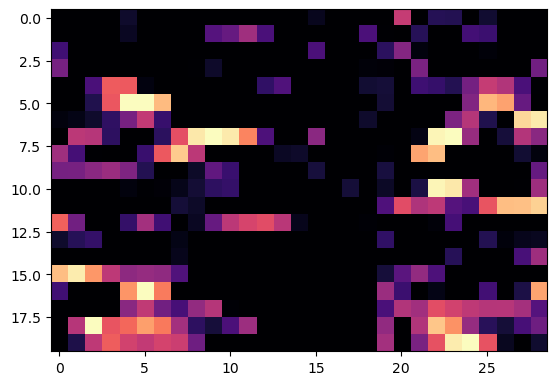

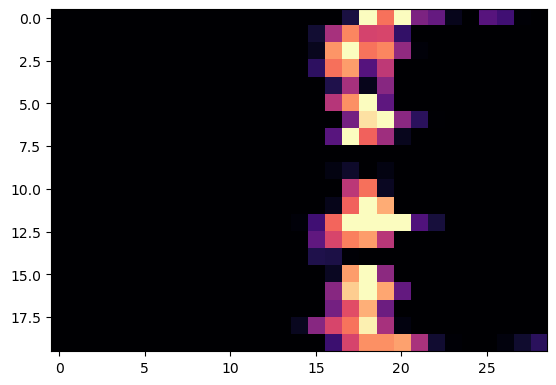

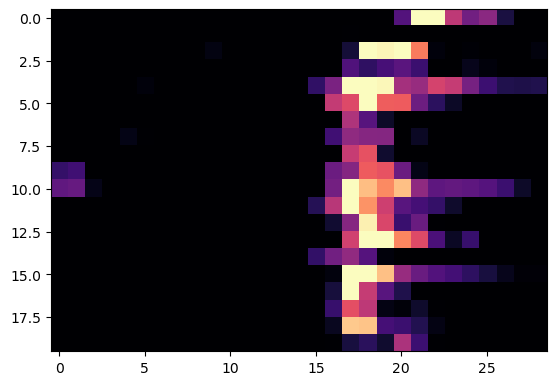

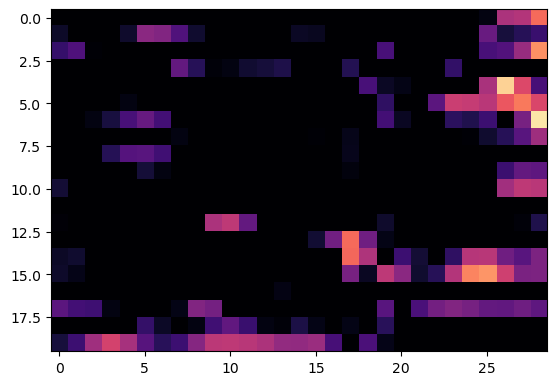

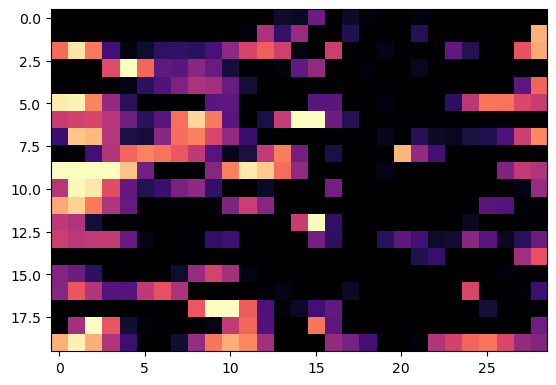

...

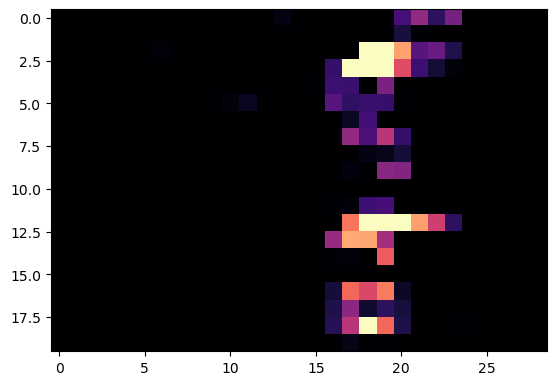

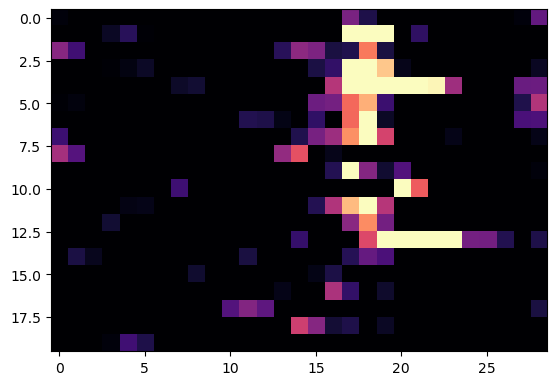

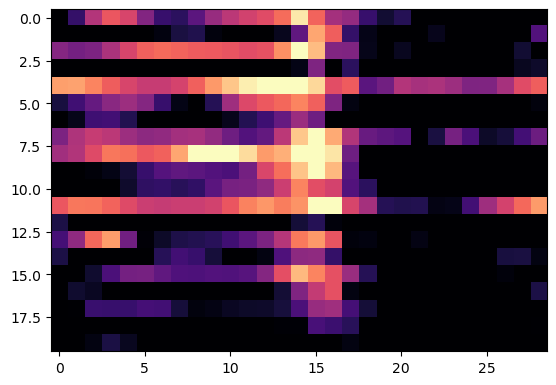

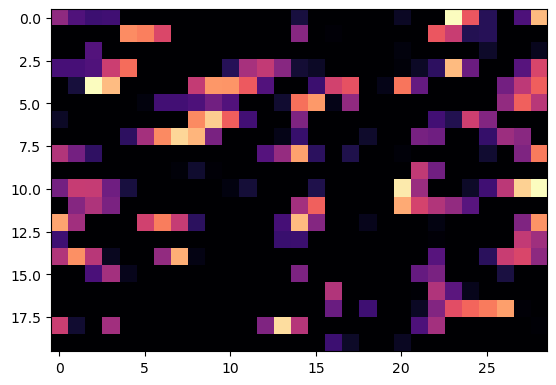

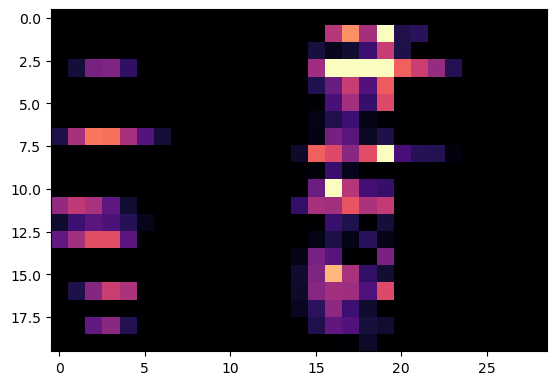

In [143]:
prop_trials_reactive = rr.post_reward_reactivation_mask[:,rr.trial_info['LR']==rr.novel_arm].sum(axis=1)/rr.post_reward_reactivation_mask[:,rr.trial_info['LR']==rr.novel_arm].shape[1]
sort = np.argsort(prop_trials_reactive)[::-1]

sort[0]
for cell in range(30):
    
    fig, ax = plt.subplots()
    ax.imshow(rr.trial_mat[rr.trial_info['LR']==rr.novel_arm,:-1,sort[cell]], vmin=.2, vmax=1, cmap='magma')

### Plot proportion reactivated

In [12]:
# plot proportion of reactivation
df_prop_reactive = {'ctrl/cre': [], 'day': [], 'mouse': [], 'fam': [], 'nov': [], 'combined': []}


for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    for day in range(6):
        for mouse in mice:
            with open(rr_dict[cond_key][day][mouse],'rb') as file:
                rr = pickle.load(file)
            
            df_prop_reactive['ctrl/cre'].append(cond_key)
            df_prop_reactive['day'].append(day)
            df_prop_reactive['mouse'].append(mouse)
            
            # all 
            df_prop_reactive['combined'].append((rr.post_reward_activation_mask.sum(axis=-1)>0).sum()/rr.spks.shape[0])
            # fam
            fam_mask = rr.lr==-1*rr.novel_arm
            df_prop_reactive['fam'].append((rr.post_reward_activation_mask[:, fam_mask].sum(axis=-1)>0).sum()/rr.spks.shape[0])
            # nov
            df_prop_reactive['nov'].append((rr.post_reward_activation_mask[:, ~fam_mask].sum(axis=-1)>0).sum()/rr.spks.shape[0])

df_prop_reactive = pd.DataFrame(df_prop_reactive)

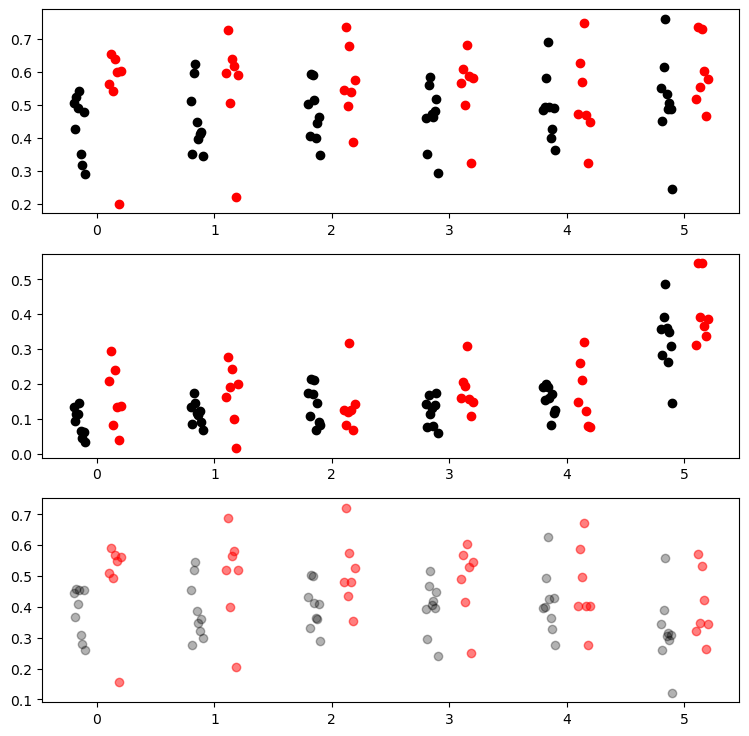

In [13]:
fig, ax = plt.subplots(3,1, figsize = [9,9])


for day in range(6):
    
    mask = (df_prop_reactive['ctrl/cre']=='ctrl') * (df_prop_reactive['day']==day) 
    df_plot = df_prop_reactive[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['combined'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam'], color='black')
    ax[2].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov'], color='black', alpha=.3)
    
    mask = (df_prop_reactive['ctrl/cre']=='cre') * (df_prop_reactive['day']==day) 
    df_plot = df_prop_reactive[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['combined'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam'], color='red')
    ax[2].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov'], color='red', alpha=.5)
    
        

In [9]:
aov = mixed_anova(data=df_prop_reactive, dv='combined', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.115929    1   14  0.115929  2.124442  0.167030  0.131753   
1          day  0.017139    5   70  0.003428  1.493950  0.202907  0.096422   
2  Interaction  0.009309    5   70  0.001862  0.811427  0.545486  0.054784   

        eps  
0       NaN  
1  0.611364  
2       NaN  


In [10]:
aov = mixed_anova(data=df_prop_reactive, dv='fam', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS          F         p-unc  \
0     ctrl/cre  0.114835    1   14  0.114835   3.455153  8.420282e-02   
1          day  0.864479    5   70  0.172896  61.297910  3.254610e-24   
2  Interaction  0.026526    5   70  0.005305   1.880888  1.086782e-01   

        np2       eps  
0  0.197945       NaN  
1  0.814072  0.779357  
2  0.118437       NaN  


In [11]:
aov = mixed_anova(data=df_prop_reactive, dv='nov', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.146901    1   14  0.146901  2.434810  0.140983  0.148150   
1          day  0.115911    5   70  0.023182  8.957210  0.000001  0.390170   
2  Interaction  0.011315    5   70  0.002263  0.874403  0.502864  0.058786   

        eps  
0       NaN  
1  0.612132  
2       NaN  


# Show difference in activity rate between reactivated and non-reactivated cells

In [17]:
# plot proportion of reactivation
df_activity_rate = {'ctrl/cre': [], 'day': [], 'mouse': [], 'fam': [], 'nov': [] }


for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    for day in range(6):
        for mouse in mice:
            with open(rr_dict[cond_key][day][mouse],'rb') as file:
                rr = pickle.load(file)
                
            df_activity_rate['ctrl/cre'].append(cond_key)
            df_activity_rate['day'].append(day)
            df_activity_rate['mouse'].append(mouse)
            
            fam_trial_mask = (rr.trial_info['LR']==(-1*rr.novel_arm))*(rr.trial_info['block_number']==5)
            nov_trial_mask = rr.trial_info['LR']==rr.novel_arm
            
            fam_mask = (rr.lr==-1*rr.novel_arm)*(rr.block_number==5)
            fam_activated = rr.post_reward_activation_mask[:,fam_mask].sum(axis=-1)>0
            fam_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[fam_trial_mask,:, :][:, :, fam_activated],axis=0),axis=0)
            fam_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[nov_trial_mask,:, :][:, :, fam_activated],axis=0),axis=0)
            df_activity_rate['fam'].append(((fam_activity_rate-nov_activity_rate)/(fam_activity_rate+nov_activity_rate)).mean())
            
            nov_mask = rr.lr==rr.novel_arm
            nov_activated = rr.post_reward_activation_mask[:,nov_mask].sum(axis=-1)>0
            fam_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[fam_trial_mask,:, :][:, :, nov_activated],axis=0),axis=0)
            nov_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[nov_trial_mask,:, :][:, :, nov_activated],axis=0),axis=0)
            df_activity_rate['nov'].append(((fam_activity_rate-nov_activity_rate)/(fam_activity_rate+nov_activity_rate)).mean())
            
df_activity_rate = pd.DataFrame(df_activity_rate)
            
                

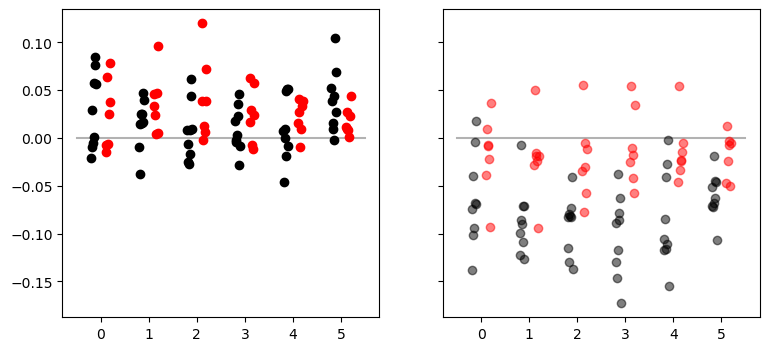

In [30]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)


for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_prop_reactive['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_prop_reactive['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov'], color='red', alpha=.5)
    
ax[0].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)
ax[1].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)
    

In [31]:
aov = mixed_anova(data=df_activity_rate, dv='fam', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.002138    1   14  0.002138  0.765590  0.396348  0.051850   
1          day  0.002941    5   70  0.000588  0.980746  0.435749  0.065467   
2  Interaction  0.007913    5   70  0.001583  2.638757  0.030407  0.158591   

        eps  
0       NaN  
1  0.671751  
2       NaN  


In [32]:
aov = mixed_anova(data=df_activity_rate, dv='nov', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS          F     p-unc       np2  \
0     ctrl/cre  0.098464    1   14  0.098464  15.460050  0.001504  0.524780   
1          day  0.006239    5   70  0.001248   2.305445  0.053506  0.141391   
2  Interaction  0.006837    5   70  0.001367   2.526399  0.036808  0.152871   

        eps  
0       NaN  
1  0.824665  
2       NaN  


In [11]:
# plot proportion of reactivation
df_activity_rate = {'ctrl/cre': [], 'day': [], 'mouse': [], 'fam': [], 'nov': [] }


for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    for day in range(6):
        for mouse in mice:
            with open(rr_dict[cond_key][day][mouse],'rb') as file:
                rr = pickle.load(file)
                
            df_activity_rate['ctrl/cre'].append(cond_key)
            df_activity_rate['day'].append(day)
            df_activity_rate['mouse'].append(mouse)
            
            fam_trial_mask = rr.trial_info['LR']==(-1*rr.novel_arm)
            nov_trial_mask = rr.trial_info['LR']==rr.novel_arm
            
            fam_mask = (rr.lr==-1*rr.novel_arm)
            fam_activated = rr.post_reward_activation_mask[:,fam_mask].sum(axis=-1)>0
            fam_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[fam_trial_mask,:, :][:, :, fam_activated],axis=0),axis=0)
            fam_nonactivity_rate = np.nanmean(np.nanmean(rr.trial_mat[fam_trial_mask,:, :][:, :, ~fam_activated],axis=0),axis=0)
            df_activity_rate['fam'].append(fam_activity_rate.mean()-fam_nonactivity_rate.mean())
            
            nov_mask = rr.lr==rr.novel_arm
            nov_activated = rr.post_reward_activation_mask[:,nov_mask].sum(axis=-1)>0
            nov_activity_rate = np.nanmean(np.nanmean(rr.trial_mat[nov_trial_mask,:, :][:, :, nov_activated],axis=0),axis=0)
            nov_nonactivity_rate = np.nanmean(np.nanmean(rr.trial_mat[nov_trial_mask,:, :][:, :, ~nov_activated],axis=0),axis=0)
            df_activity_rate['nov'].append(nov_activity_rate.mean()-nov_nonactivity_rate.mean())
            
df_activity_rate = pd.DataFrame(df_activity_rate)

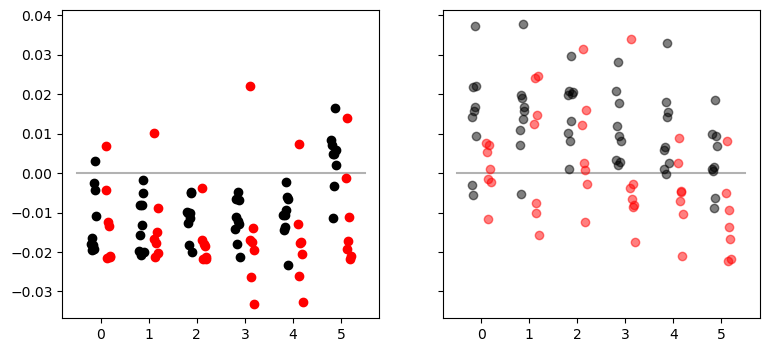

In [12]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)


for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov'], color='red', alpha=.5)
    
ax[0].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)
ax[1].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)

In [13]:
aov = mixed_anova(data=df_activity_rate[df_activity_rate['day']<5], dv='fam', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.000215    1   14  0.000215  0.609563  0.447953  0.041724   
1          day  0.000040    4   56  0.000010  0.453309  0.769554  0.031364   
2  Interaction  0.000130    4   56  0.000033  1.495233  0.216004  0.096496   

        eps  
0       NaN  
1  0.763439  
2       NaN  


/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in double_scalars
  W = np.product(eig) / (eig.sum() / d) ** d


In [14]:
aov = mixed_anova(data=df_activity_rate[df_activity_rate['day']<5], dv='nov', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.002918    1   14  0.002918  6.175613  0.026211  0.306093   
1          day  0.000780    4   56  0.000195  3.238530  0.018457  0.187866   
2  Interaction  0.000146    4   56  0.000036  0.605290  0.660444  0.041443   

        eps  
0       NaN  
1  0.757095  
2       NaN  


/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in double_scalars
  W = np.product(eig) / (eig.sum() / d) ** d


# Correlation between activity rate maps 

In [41]:
df_activity_rate = {'ctrl/cre': [], 'day': [], 'mouse': [], 'fam': [], 'nov': [] }


for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    for day in range(6):
        for mouse in mice:
            with open(rr_dict[cond_key][day][mouse],'rb') as file:
                rr = pickle.load(file)
                
            df_activity_rate['ctrl/cre'].append(cond_key)
            df_activity_rate['day'].append(day)
            df_activity_rate['mouse'].append(mouse)
            
            fam_trial_mask = rr.trial_info['LR']==-1*rr.novel_arm
            nov_trial_mask = rr.trial_info['LR']==rr.novel_arm
            
            fam_mask = rr.lr==-1*rr.novel_arm
            fam_activated = rr.post_reward_activation_mask[:,fam_mask].sum(axis=-1)>0
            fam_activity_rate = sp.stats.zscore(np.nanmean(rr.trial_mat[fam_trial_mask,10:, :][:, :, fam_activated],axis=0),axis=0)
            nov_activity_rate = sp.stats.zscore(np.nanmean(rr.trial_mat[nov_trial_mask,10:, :][:, :, fam_activated],axis=0), axis=0)
            
            df_activity_rate['fam'].append(np.nanmean(1/fam_activity_rate.shape[0]*np.diagonal(np.matmul(fam_activity_rate.T,nov_activity_rate))))
            
            nov_mask = rr.lr==rr.novel_arm
            nov_activated = rr.post_reward_activation_mask[:,nov_mask].sum(axis=-1)>0
            fam_activity_rate = sp.stats.zscore(np.nanmean(rr.trial_mat[fam_trial_mask,10:, :][:, :, nov_activated],axis=0), axis=0)
            nov_activity_rate = sp.stats.zscore(np.nanmean(rr.trial_mat[nov_trial_mask,10:, :][:, :, nov_activated],axis=0), axis=0)
            df_activity_rate['nov'].append(np.nanmean(1/fam_activity_rate.shape[0]*np.diagonal(np.matmul(fam_activity_rate.T, nov_activity_rate)))) 
                
df_activity_rate = pd.DataFrame(df_activity_rate)         

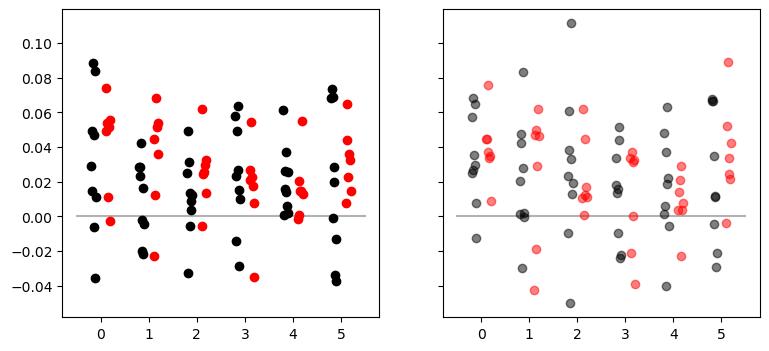

In [43]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)


for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_prop_reactive['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_prop_reactive['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov'], color='red', alpha=.5)
    
ax[0].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)
ax[1].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)

# Trial x trial correlation

In [5]:
df_activity_rate = {'ctrl/cre': [], 'day': [], 'mouse': [], 
                    'fam_activated': [], 'fam_nonactivated': [], 'fam_corrdiff': [],
                    'nov_activated': [], 'nov_nonactivated': [], 'nov_corrdiff': [] }


for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    for day in range(6):
        print(day)
        for mouse in mice:
            
            with open(rr_dict[cond_key][day][mouse],'rb') as file:
                rr = pickle.load(file)
                
            df_activity_rate['ctrl/cre'].append(cond_key)
            df_activity_rate['day'].append(day)
            df_activity_rate['mouse'].append(mouse)
            
            zscore_tmat = 1*np.copy(rr.trial_mat)
            # zscore_tmat[np.isnan(zscore_tmat)]=0
            zscore_tmat = sp.stats.zscore(zscore_tmat, axis=1, nan_policy='omit')
            zscore_tmat[np.isnan(zscore_tmat)] = 0
            
            corr_tmat = 1/zscore_tmat.shape[1]*np.matmul(np.transpose(zscore_tmat, axes=(2, 0, 1)), np.transpose(zscore_tmat, axes=(2, 1, 0)))
            corr_tmat = np.arctanh(np.minimum(np.maximum(corr_tmat, -1+1E-5), 1-1E-5))
            
            fam_trial_mask = rr.trial_info['LR']==-1*rr.novel_arm
            nov_trial_mask = rr.trial_info['LR']==rr.novel_arm
            
            fam_mask = rr.lr==-1*rr.novel_arm
            fam_activated = rr.post_reward_activation_mask[:,fam_mask].sum(axis=-1)>0
            
            
            fam_activated_tt_corr = corr_tmat[fam_activated, :, :][:, fam_trial_mask, :][:, :, fam_trial_mask].mean(axis=-1).mean(axis=-1).mean()
            df_activity_rate['fam_activated'].append(fam_activated_tt_corr)
            
        
            fam_nonactivated_tt_corr = corr_tmat[~fam_activated, :, :][:, fam_trial_mask, :][:, :, fam_trial_mask].mean(axis=-1).mean(axis=-1).mean()
            df_activity_rate['fam_nonactivated'].append(fam_nonactivated_tt_corr)
            
            
            df_activity_rate['fam_corrdiff'].append(fam_activated_tt_corr-fam_nonactivated_tt_corr)
            
            
            nov_mask = rr.lr==rr.novel_arm
            nov_activated = rr.post_reward_activation_mask[:,nov_mask].sum(axis=-1)>0
            
            # nov_activity_rate = sp.stats.zscore(rr.trial_mat[nov_trial_mask,:, :][:, :, nov_activated], axis=1, nan_policy='omit')
            # nov_activity_rate[np.isnan(nov_activity_rate)]=0
            # tt_corr = 1/rr.trial_mat.shape[1]*np.matmul(np.transpose(nov_activity_rate, axes=(2,0,1)), np.transpose(nov_activity_rate, axes=(2, 1, 0)))
            # # tt_corr = np.arctanh(np.minimum(np.maximum(tt_corr,-1+1E-5),1-1E-5))
            # nov_activated_tt_corr = np.array([tt_corr[i, np.triu_indices(tt_corr.shape[1],k=1)].mean() for i in range(tt_corr.shape[0])]).mean()
            nov_activated_tt_corr = corr_tmat[nov_activated, :, :][:, nov_trial_mask, :][:, :, nov_trial_mask].mean(axis=-1).mean(axis=-1).mean()
            df_activity_rate['nov_activated'].append(nov_activated_tt_corr)
            
            
            nov_nonactivated_tt_corr = corr_tmat[~nov_activated, :, :][:, nov_trial_mask, :][:, :, nov_trial_mask].mean(axis=-1).mean(axis=-1).mean()
            df_activity_rate['nov_nonactivated'].append(nov_nonactivated_tt_corr)
            
            df_activity_rate['nov_corrdiff'].append(nov_activated_tt_corr - nov_nonactivated_tt_corr)
            
# df_activity_rate       
df_activity_rate = pd.DataFrame(df_activity_rate)

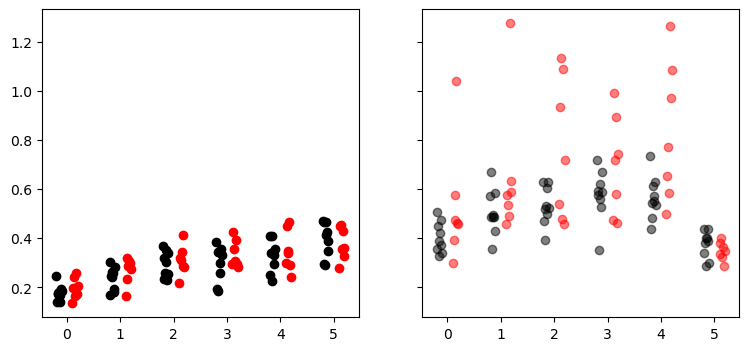

In [6]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)

for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam_activated'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov_activated'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam_activated'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov_activated'], color='red', alpha=.5)
    


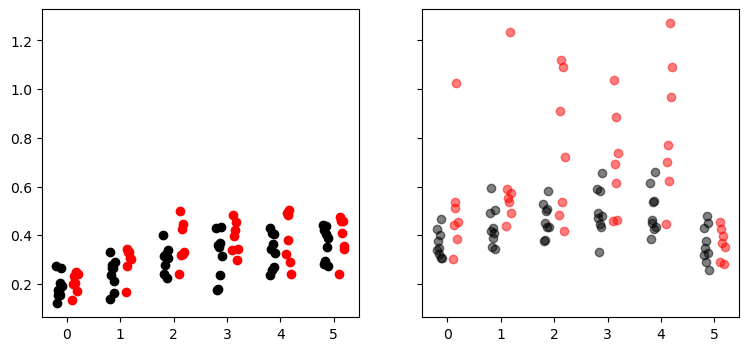

In [7]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)


for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam_nonactivated'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov_nonactivated'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam_nonactivated'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov_nonactivated'], color='red', alpha=.5)

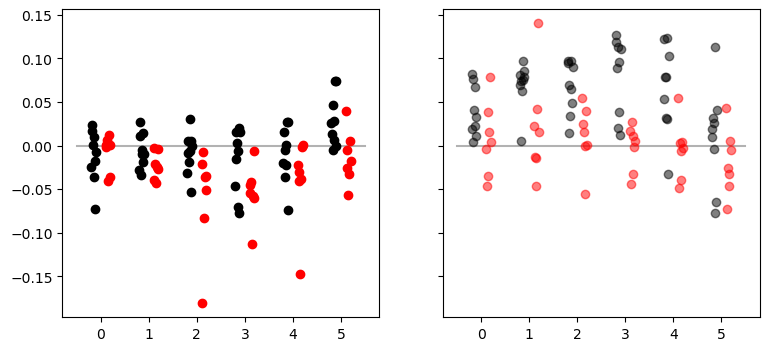

In [8]:
fig, ax = plt.subplots(1,2, figsize = [9,4], sharey=True)


for day in range(6):
    
    mask = (df_activity_rate['ctrl/cre']=='ctrl') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    
    ax[0].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['fam_corrdiff'], color='black')
    ax[1].scatter(day + np.linspace(-.2,-.1, num=len(ctrl_mice)), df_plot['nov_corrdiff'], color='black', alpha=.5)
    
    
    mask = (df_activity_rate['ctrl/cre']=='cre') * (df_activity_rate['day']==day) 
    df_plot = df_activity_rate[mask]
    ax[0].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['fam_corrdiff'], color='red')
    ax[1].scatter(day + np.linspace(.1,.2, num=len(ko_mice)), df_plot['nov_corrdiff'], color='red', alpha=.5)
    
ax[0].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)
ax[1].plot([-.5,5.5],[0,0], color='black', zorder=-1, alpha=.3)

In [9]:
aov = mixed_anova(data=df_activity_rate[df_activity_rate['day']<5], dv='fam_corrdiff', between='ctrl/cre', within='day', subject='mouse')
print(aov)

aov = mixed_anova(data=df_activity_rate[df_activity_rate['day']<5], dv='nov_corrdiff', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.013517    1   14  0.013517  4.024464  0.064565  0.223278   
1          day  0.006900    4   56  0.001725  2.862178  0.031468  0.169739   
2  Interaction  0.006577    4   56  0.001644  2.728390  0.038060  0.163099   

       eps  
0      NaN  
1  0.69476  
2      NaN  
        Source        SS  DF1  DF2        MS          F     p-unc       np2  \
0     ctrl/cre  0.066904    1   14  0.066904  14.744565  0.001803  0.512951   
1          day  0.005350    4   56  0.001338   1.715431  0.159436  0.109156   
2  Interaction  0.006082    4   56  0.001520   1.949918  0.114834  0.122253   

        eps  
0       NaN  
1  0.607756  
2       NaN  


In [43]:
aov = mixed_anova(data=df_activity_rate, dv='fam_activated', between='ctrl/cre', within='day', subject='mouse')
print(aov)

aov = mixed_anova(data=df_activity_rate, dv='nov_nonactivated', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS          F         p-unc  \
0     ctrl/cre  0.007507    1   14  0.007507   0.508182  4.876396e-01   
1          day  0.395412    5   70  0.079082  59.999309  5.948479e-24   
2  Interaction  0.007138    5   70  0.001428   1.083068  3.773742e-01   

        np2       eps  
0  0.035027       NaN  
1  0.810809  0.526439  
2  0.071807       NaN  
        Source        SS  DF1  DF2        MS          F         p-unc  \
0     ctrl/cre  0.911196    1   14  0.911196   8.606995  1.089013e-02   
1          day  0.915432    5   70  0.183086  14.358059  1.148810e-09   
2  Interaction  0.262496    5   70  0.052499   4.117112  2.462298e-03   

   p-GG-corr       np2       eps sphericity   W-spher   p-spher  
0        NaN  0.380723       NaN        NaN       NaN       NaN  
1   0.000005  0.506313  0.631004      False  0.083145  0.003749  
2        NaN  0.227250       NaN        NaN       NaN       NaN  


/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/pingouin/parametric.py:1568: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  aov = pd.concat([aov_betw.drop(1), aov_with.drop(1)], axis=0, sort=False, ignore_index=True)


# Across days

In [29]:
import pickle
rr_dict_multiday = {}
basedir = '/home/mplitt/YMazeRewardReactPkls/'
for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    rr_dict_multiday[cond_key] = {}
    for mouse in mice:
        print(mouse,day)
        rr = RewardReactivation(u.single_mouse_concat_sessions(mouse, date_inds = np.arange(6), load_stats=False))
        filename = basedir + f'{mouse}_days1_to_.pkl'
        with open(filename, 'wb') as file:
            pickle.dump(rr,file)

        rr_dict_multiday[cond_key][mouse]=filename

4467331.1 1
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
4467331.2 1
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
4467332.1 1
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
4467332.2 1
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
4467333.1 1
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


05_12_2020 YMaze_LNovel
mCherry6 1
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
mCherry7 1
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
mCherry8 1
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
mCherry9 1
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel
4467975.1 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
4467975.2 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


01_10_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


02_10_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


03_10_2020 YMaze_LNovel
4467975.3 1


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
4467975.4 1
28_09_2020 YMaze_LNovel
29_09_2020 YMaze_LNovel
30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
4467975.5 1
28_09_2020 YMaze_LNovel
29_09_2020 YMaze_LNovel
30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
Cre7 1
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel
22_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel
Cre9 1
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel


In [16]:
import pickle
rr_dict_multiday = {}
basedir = '/home/mplitt/YMazeRewardReactPkls/'
for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    rr_dict_multiday[cond_key] = {}
    for mouse in mice:
        filename = basedir + f'{mouse}_days1_to_.pkl'
        rr_dict_multiday[cond_key][mouse]=filename

In [28]:
df = {'ctrl/cre': [], 'curr_day': [], 'fut_day': [], 'mouse': [], 
                    'fam_activated': [], 'fam_nonactivated': [], 'fam_corrdiff': [],
                    'nov_activated': [], 'nov_nonactivated': [], 'nov_corrdiff': [] }


corr_dict = {'ctrl':{}, 'cre':{}}
for cond_key, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
    corr_dict[cond_key]['nov_activated'] = np.zeros((len(mice),5,5))*np.nan
    corr_dict[cond_key]['nov_nonactivated'] = np.zeros((len(mice),5,5))*np.nan
    corr_dict[cond_key]['fam_activated'] = np.zeros((len(mice),5,5))*np.nan
    corr_dict[cond_key]['fam_nonactivated'] = np.zeros((len(mice),5,5))*np.nan
    for m, mouse in enumerate(mice):
        print(mouse)
        with open(rr_dict_multiday[cond_key][mouse], 'rb') as file:
            rr = pickle.load(file)
        
            
        for day in range(5):
            first_ind = rr.trial_start_inds[rr.trial_info['sess_num']==day][0]
            last_ind = rr.teleport_inds[rr.trial_info['sess_num']==day][-1]
            # print(first_ind, last_ind)

            lr = rr.lr[first_ind:last_ind]
            post_reward_activation_mask = rr.post_reward_activation_mask[:,first_ind:last_ind]
            nov_activated = post_reward_activation_mask[:,lr==rr.novel_arm].sum(axis=-1)>0
            fam_activated = post_reward_activation_mask[:,lr==-1*rr.novel_arm].sum(axis=-1)>0

            day_mask = rr.trial_info['sess_num']==day
            nov_mask = rr.trial_info['LR']==rr.novel_arm
            fam_mask = rr.trial_info['LR']==-1*rr.novel_arm

            day_nov_active_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[day_mask*nov_mask,: :][:, :, nov_activated], axis=0), axis=0, nan_policy='omit')
            day_nov_active_tmat[np.isnan(day_nov_active_tmat)]=0

            day_nov_nonactive_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[day_mask*nov_mask,: :][:, :, ~nov_activated], axis=0), axis=0, nan_policy='omit')
            day_nov_nonactive_tmat[np.isnan(day_nov_nonactive_tmat)]=0

            day_fam_active_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[day_mask*fam_mask,: :][:, :, fam_activated], axis=0), axis=0, nan_policy='omit')
            day_fam_active_tmat[np.isnan(day_fam_active_tmat)]=0

            day_fam_nonactive_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[day_mask*fam_mask,: :][:, :, ~fam_activated], axis=0), axis=0, nan_policy='omit')
            day_fam_nonactive_tmat[np.isnan(day_fam_nonactive_tmat)]=0

            for futday in range(day+1, 6):

                futday_mask = rr.trial_info['sess_num']==futday

                futday_nov_active_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[futday_mask*nov_mask,: :][:, :, nov_activated], axis=0), axis=0, nan_policy='omit')
                futday_nov_active_tmat[np.isnan(futday_nov_active_tmat)]=0

                futday_nov_nonactive_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[futday_mask*nov_mask,: :][:, :, ~nov_activated], axis=0), axis=0, nan_policy='omit')
                futday_nov_nonactive_tmat[np.isnan(futday_nov_nonactive_tmat)]=0

                futday_fam_active_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[futday_mask*fam_mask,: :][:, :, fam_activated], axis=0), axis=0, nan_policy='omit')
                futday_fam_active_tmat[np.isnan(futday_fam_active_tmat)]=0

                futday_fam_nonactive_tmat = sp.stats.zscore(np.nanmean(rr.trial_mat[futday_mask*fam_mask,: :][:, :, ~fam_activated], axis=0), axis=0, nan_policy='omit')
                futday_fam_nonactive_tmat[np.isnan(futday_fam_nonactive_tmat)]=0
                
                corr_func = lambda mat1, mat2: np.diagonal(1/rr.trial_mat.shape[1]*np.arctanh(np.minimum(np.maximum(np.matmul(mat1.T, mat2), -1+1E-5), 1-1E-5))).mean()
                
                _nov_activated = np.diagonal(1/rr.trial_mat.shape[1]*np.matmul(day_nov_active_tmat.T, futday_nov_active_tmat)).mean()
                _nov_nonactivated = np.diagonal(1/rr.trial_mat.shape[1]*np.matmul(day_nov_nonactive_tmat.T, futday_nov_nonactive_tmat)).mean()
                _fam_activated = np.diagonal(1/rr.trial_mat.shape[1]*np.matmul(day_fam_active_tmat.T, futday_fam_active_tmat)).mean()
                _fam_nonactivated = np.diagonal(1/rr.trial_mat.shape[1]*np.matmul(day_fam_nonactive_tmat.T, futday_fam_nonactive_tmat)).mean()
                
                # print(np.isnan(_nov_activated).sum(),np.isnan(_nov_nonactivated).sum(), np.isnan(_fam_activated).sum(), np.isnan(_fam_nonactivated).sum())
                corr_dict[cond_key]['nov_activated'][m, day, futday-1] = _nov_activated
                corr_dict[cond_key]['nov_nonactivated'] [m, day, futday-1] = _nov_nonactivated
                corr_dict[cond_key]['fam_activated'] [m, day, futday-1] = _fam_activated
                corr_dict[cond_key]['fam_nonactivated'] [m, day, futday-1] = _fam_nonactivated
                
                
                df['ctrl/cre'].append(cond_key)
                df['mouse'].append(mouse)
                df['curr_day'].append(day)
                df['fut_day'].append(futday)
                df['nov_activated'].append(_nov_activated)
                df['nov_nonactivated'].append(_nov_nonactivated)
                df['nov_corrdiff'].append(_nov_activated-_nov_nonactivated)
                df['fam_activated'].append(_fam_activated)
                df['fam_nonactivated'].append(_fam_nonactivated)
                df['fam_corrdiff'].append(_fam_activated-_fam_nonactivated)
df = pd.DataFrame(df) 

4467331.1
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
4467331.2
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
4467332.1
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
4467332.2
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
4467333.1
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
mCherry6
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
mCherry7
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
mCherry8
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0 0 0
0 0

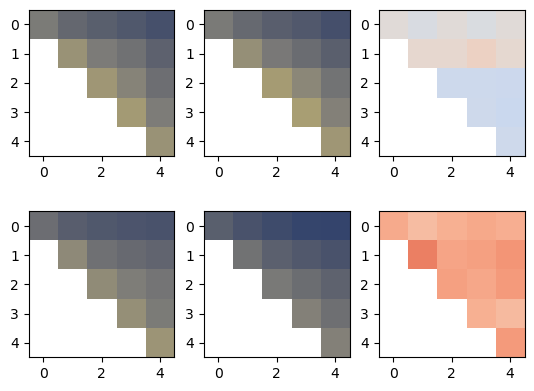

In [19]:
fig, ax = plt.subplots(2,3)
ax[0,0].imshow(corr_dict['ctrl']['fam_activated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[0,1].imshow(corr_dict['ctrl']['fam_nonactivated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[0,2].imshow((corr_dict['ctrl']['fam_activated']-corr_dict['ctrl']['fam_nonactivated']).mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)


ax[1,0].imshow(corr_dict['ctrl']['nov_activated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[1,1].imshow(corr_dict['ctrl']['nov_nonactivated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[1,2].imshow((corr_dict['ctrl']['nov_activated']-corr_dict['ctrl']['nov_nonactivated']).mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)


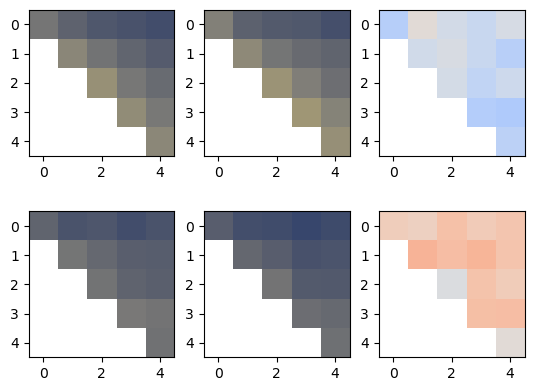

In [20]:
fig, ax = plt.subplots(2,3)
ax[0,0].imshow(corr_dict['cre']['fam_activated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[0,1].imshow(corr_dict['cre']['fam_nonactivated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[0,2].imshow((corr_dict['cre']['fam_activated']-corr_dict['cre']['fam_nonactivated']).mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)


ax[1,0].imshow(corr_dict['cre']['nov_activated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[1,1].imshow(corr_dict['cre']['nov_nonactivated'].mean(axis=0), cmap='cividis', vmin=0, vmax=1)
ax[1,2].imshow((corr_dict['cre']['nov_activated']-corr_dict['cre']['nov_nonactivated']).mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)

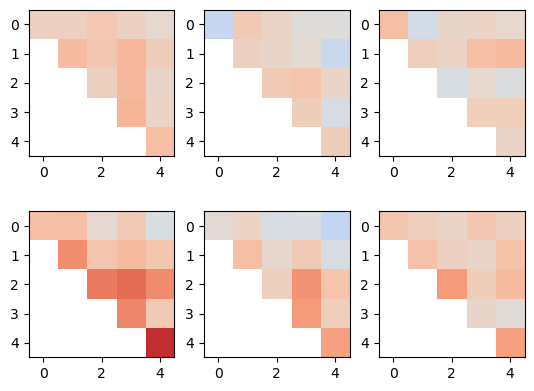

In [25]:
fig, ax = plt.subplots(2,3)
ax[0,0].imshow(corr_dict['ctrl']['fam_activated'].mean(axis=0) - corr_dict['cre']['fam_activated'].mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)
ax[0,1].imshow(corr_dict['ctrl']['fam_nonactivated'].mean(axis=0) - corr_dict['cre']['fam_nonactivated'].mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)

ctrl_diff = (corr_dict['ctrl']['fam_activated']-corr_dict['ctrl']['fam_nonactivated']).mean(axis=0)
cre_diff = (corr_dict['cre']['fam_activated']-corr_dict['cre']['fam_nonactivated']).mean(axis=0)
ax[0,2].imshow(ctrl_diff-cre_diff, cmap='coolwarm', vmin=-.2, vmax=.2)

ax[1,0].imshow(corr_dict['ctrl']['nov_activated'].mean(axis=0) - corr_dict['cre']['nov_activated'].mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)
ax[1,1].imshow(corr_dict['ctrl']['nov_nonactivated'].mean(axis=0) - corr_dict['cre']['nov_nonactivated'].mean(axis=0), cmap='coolwarm', vmin=-.2, vmax=.2)

ctrl_diff = (corr_dict['ctrl']['nov_activated']-corr_dict['ctrl']['nov_nonactivated']).mean(axis=0)
cre_diff = (corr_dict['cre']['nov_activated']-corr_dict['cre']['nov_nonactivated']).mean(axis=0)
ax[1,2].imshow(ctrl_diff-cre_diff, cmap='coolwarm', vmin=-.2, vmax=.2)

In [55]:

mask = df['fut_day']-df['curr_day']==1
# df[mask]

aov = mixed_anova(data=df[mask], dv='nov_corrdiff', between='ctrl/cre', within='curr_day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.074927    1   14  0.074927  6.170521  0.026263  0.305918   
1     curr_day  0.024344    4   56  0.006086  1.670309  0.169743  0.106591   
2  Interaction  0.016853    4   56  0.004213  1.156335  0.339903  0.076294   

        eps  
0       NaN  
1  0.814433  
2       NaN  


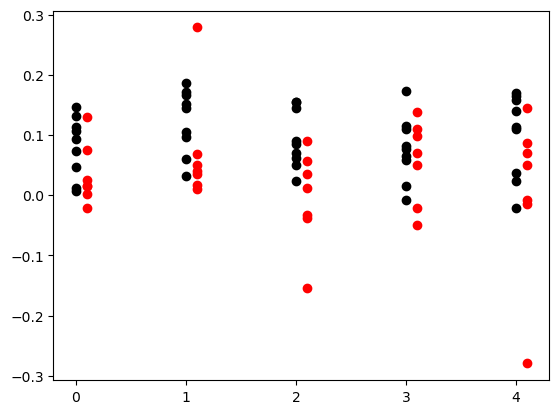

In [57]:

fig, ax = plt.subplots()
_df = df[mask*(df['ctrl/cre']=='ctrl')]
ax.scatter(_df['curr_day'],_df['nov_corrdiff'], color='black')
_df = df[mask*(df['ctrl/cre']=='cre')]
ax.scatter(_df['curr_day']+.1,_df['nov_corrdiff'], color='red')

In [75]:
mask = df['fut_day']-df['curr_day']==1
_df = df[mask*(df['ctrl/cre']=='ctrl')]
for day in range(5):
    for fut_day in range(day+1,6):
        mask = (df['curr_day']==day_)*(df['fut_day']==fut_day)*(df['ctrl/cre']=='ctrl')
        _df
    _day_df = _df[df['curr_day']==day]
    # print(_day_df['nov_corrdiff'].to_numpy())
    t, p = sp.stats.ttest_1samp(_day_df['nov_corrdiff'].to_numpy(),0)
    print(day, t, p)

0 4.861869134643677 0.0012528272285414678
1 6.978772832966865 0.00011505329542485125
2 5.785035425551957 0.0004121398417355953
3 4.221311516636713 0.0029106141364803532
4 4.282906920261956 0.0026769474983347713


/tmp/ipykernel_2282673/2965730845.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  _day_df = _df[df['curr_day']==day]


1.8846815747802135 0.08040376175850071


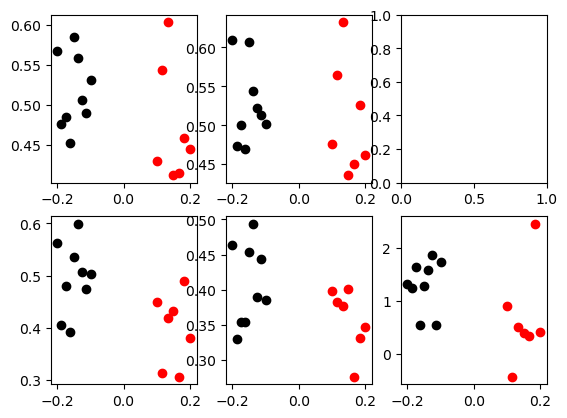

In [16]:
fig, ax = plt.subplots(2,3)
ax[0, 0].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), np.nanmean(np.nanmean(corr_dict['ctrl']['fam_activated'], axis=-1), axis=-1), color='black')
ax[0, 0].scatter(np.linspace(.1,.2,num=len(ko_mice)), np.nanmean(np.nanmean(corr_dict['cre']['fam_activated'], axis=-1), axis=-1), color='red')


ax[0, 1].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), np.nanmean(np.nanmean(corr_dict['ctrl']['fam_nonactivated'], axis=-1), axis=-1), color='black')
ax[0, 1].scatter(np.linspace(.1,.2,num=len(ko_mice)), np.nanmean(np.nanmean(corr_dict['cre']['fam_nonactivated'], axis=-1), axis=-1), color='red')


# ctrl_diff = np.nanmean(np.nanmean(corr_dict['ctrl']['fam_activated']-corr_dict['ctrl']['fam_nonactivated'], axis=-1), axis=-1)
# ax[0, 2].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), ctrl_diff, color='black')
# cre_diff = np.nanmean(np.nanmean(corr_dict['cre']['fam_activated']-corr_dict['cre']['fam_nonactivated'], axis=-1), axis=-1)
# ax[0, 2].scatter(np.linspace(.1,.2,num=len(ko_mice)), cre_diff, color='red')


ax[1, 0].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), np.nanmean(np.nanmean(corr_dict['ctrl']['nov_activated'], axis=-1), axis=-1), color='black')
ax[1, 0].scatter(np.linspace(.1,.2,num=len(ko_mice)), np.nanmean(np.nanmean(corr_dict['cre']['nov_activated'], axis=-1), axis=-1), color='red')


ax[1, 1].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), np.nanmean(np.nanmean(corr_dict['ctrl']['nov_nonactivated'], axis=-1), axis=-1), color='black')
ax[1, 1].scatter(np.linspace(.1,.2,num=len(ko_mice)), np.nanmean(np.nanmean(corr_dict['cre']['nov_nonactivated'], axis=-1), axis=-1), color='red')



ctrl_diff = np.nansum(np.nansum(corr_dict['ctrl']['nov_activated']-corr_dict['ctrl']['nov_nonactivated'],axis=-1), axis=-1)
# ctrl_diff = np.array([np.diagonal(ctrl_diff[i,:,:]).mean() for i in range(len(ctrl_mice))])
ax[1, 2].scatter(np.linspace(-.2,-.1,num=len(ctrl_mice)), ctrl_diff, color='black')

cre_diff = np.nansum(np.nansum(corr_dict['cre']['nov_activated']-corr_dict['cre']['nov_nonactivated'], axis=-1), axis=-1)
# cre_diff = np.array([np.diagonal(cre_diff[i,:,:]).mean() for i in range(len(ko_mice))])
ax[1, 2].scatter(np.linspace(.1,.2,num=len(ko_mice)), cre_diff, color='red')

# ctrl_diff = np.nanmean(np.nanmean(corr_dict['ctrl']['nov_activated']-corr_dict['ctrl']['nov_nonactivated'], axis=-1), axis=-1)
t, p =sp.stats.ttest_ind(ctrl_diff.ravel(), cre_diff.ravel())
print(t, p)

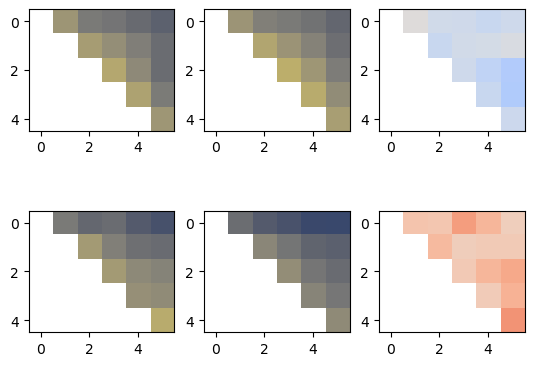

In [18]:
fig, ax = plt.subplots(2,3)
ax[0,0].imshow(corr_fam_activated, cmap='cividis', vmin=0, vmax=1)
ax[0,1].imshow(corr_fam_nonactivated, cmap='cividis', vmin=0, vmax=1)
ax[0,2].imshow(corr_fam_activated - corr_fam_nonactivated, cmap='coolwarm', vmin=-.3, vmax=.3)

ax[1,0].imshow(corr_nov_activated, cmap='cividis', vmin=0, vmax=1)
ax[1,1].imshow(corr_nov_nonactivated, cmap='cividis', vmin=0, vmax=1)
ax[1,2].imshow(corr_nov_activated - corr_nov_nonactivated, cmap='coolwarm', vmin=-.3, vmax=.3)

In [5]:
mouse = ctrl_mice[0]
sess = u.single_mouse_concat_sessions(mouse, date_inds = np.arange(6), load_stats=False)
rr = RewardReactivation(sess)

29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel


In [7]:
rr.post_reward_activation_mask.shape

(376, 195167)

In [24]:
day = 1
first_ind = rr.trial_start_inds[rr.trial_info['sess_num']==day][0]
last_ind = rr.teleport_inds[rr.trial_info['sess_num']==day][-1]
lr = rr.lr[first_ind:last_ind]
post_reward_activation_mask = rr.post_reward_activation_mask[:,first_ind:last_ind]

nov_activated = post_reward_activation_mask[:,lr==rr.novel_arm].sum(axis=-1)>0

/tmp/ipykernel_2282236/2950030466.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


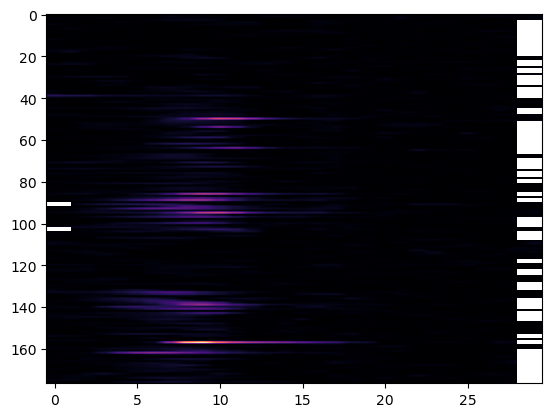

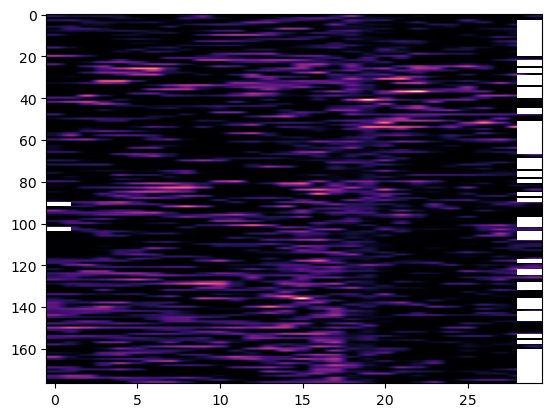

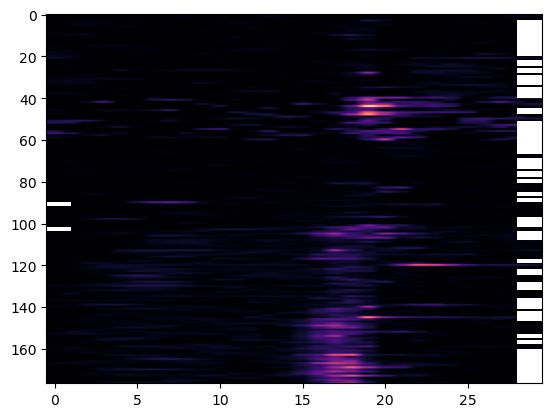

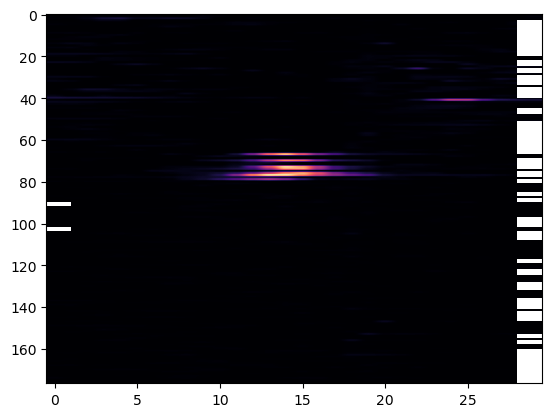

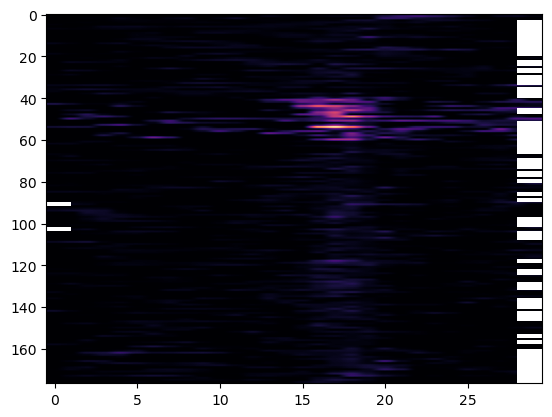

...

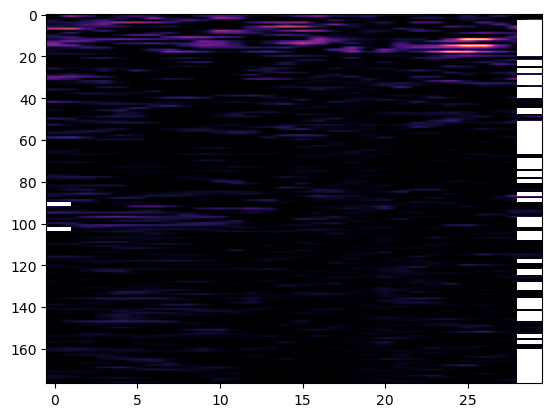

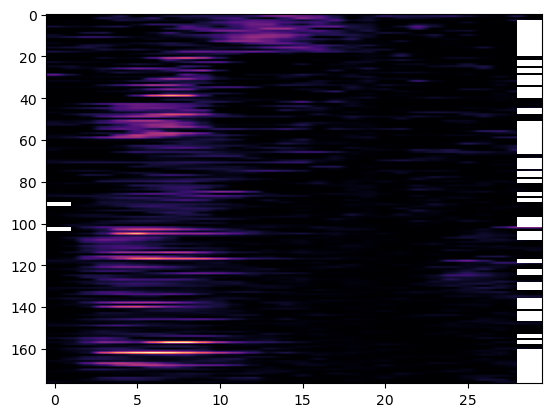

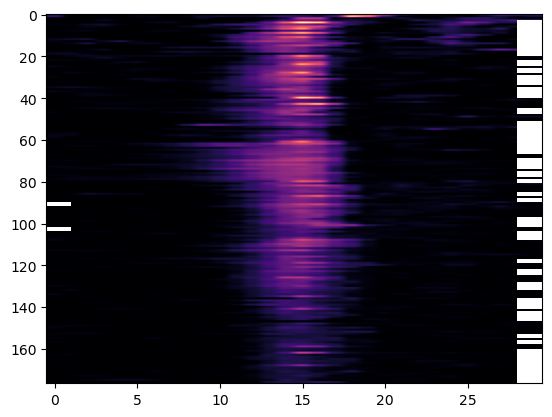

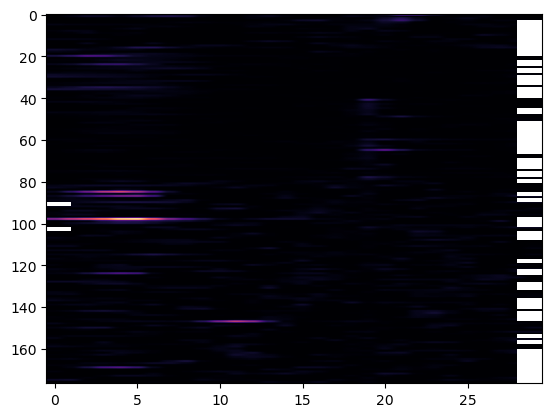

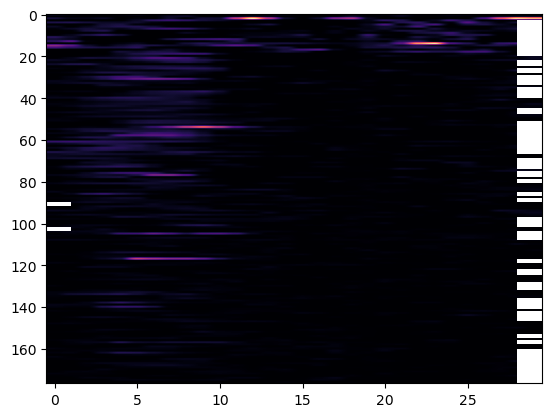

In [26]:
for i, cell in enumerate(np.argwhere(~nov_activated).ravel()):
    # if i<20:
        fig, ax = plt.subplots()
        ax.imshow(rr.trial_mat[rr.trial_info['LR']==rr.novel_arm,:,cell], cmap='magma', aspect='auto')
    

In [3]:
def post_reward_mask(sess,fr):
    post_reward_bool = 0.*sess.timeseries['t'].ravel()


    for start,stop in zip(sess.trial_start_inds, sess.teleport_inds):
    
        cum_reward = np.cumsum(sess.timeseries['reward'].ravel()[start:stop])>0
        post_reward_inds = np.argwhere(cum_reward).ravel()
        if post_reward_inds.shape[0]>0:
            
            post_reward_bool[post_reward_inds[0]+start:start+np.minimum(post_reward_inds[0]+int(5*fr),stop-start)] = 1
    

    nov_post_rzone_mask = (sess.timeseries['LR']==sess.novel_arm)*(sess.timeseries['t']>sess.rzone_nov['tfront']+3)
    fam_post_rzone_mask = (sess.timeseries['LR']==-1*sess.novel_arm)*(sess.timeseries['t']>sess.rzone_fam['tfront']+3)
    post_reward_bool[nov_post_rzone_mask.ravel()]=0
    post_reward_bool[fam_post_rzone_mask.ravel()]=0
    return post_reward_bool


def get_activation_masks(sess):
    if isinstance(sess.scan_info,list):
        fr = sess.scan_info[0]['frame_rate']
    else:
        fr = sess.scan_info['frame_rate']
    post_reward_bool = post_reward_mask(sess,fr)
    spks = fr*np.copy(sess.timeseries['spks'])
    # spks[sess.timeseries['F_dff']<.1]=0
    spks[sess.timeseries['spks']<.2*np.nanmax(sess.timeseries['spks'],axis=-1,keepdims=True)]=0
    speed = sess.timeseries['speed']
    
    spks_ledge = 1*(np.diff(1.*(spks>0),prepend=0,axis=-1)>0)
    
    reactivation_mask = 1*(spks_ledge>0)*(speed<2)
    post_reward_activation_mask = 1*(spks_ledge>0)*(speed<2)*(post_reward_bool[np.newaxis,:])#*(sess.vr_data['LR'].to_numpy()==sess.novel_arm)
    trial_activation_mask = 1*(spks_ledge>0)*(1-post_reward_bool[np.newaxis,:])
    
    return spks, speed, reactivation_mask, post_reward_activation_mask, trial_activation_mask
    

def get_post_reward_reactivation_masks(spks, trial_starts, teleports, post_reward_activation_mask, trial_activation_mask):
    post_reward_reactivation_mask = np.zeros((spks.shape[0],trial_starts.shape[0]))
    non_reactivation_mask = np.zeros((spks.shape[0],trial_starts.shape[0]))
    for trial, (start,stop) in enumerate(zip(trial_starts,teleports)):
        post_reward_reactivation_mask[:,trial] = 1*(post_reward_activation_mask[:,start:stop].sum(axis=-1)>0)*(trial_activation_mask[:,start:stop].sum(axis=-1)>0)
        non_reactivation_mask[:,trial] = 1*(post_reward_activation_mask[:,start:stop].sum(axis=-1)==0)*(trial_activation_mask[:,start:stop].sum(axis=-1)>0)
        
    return post_reward_reactivation_mask, non_reactivation_mask
    
def fam_reactivation_masks(sess):
    
    spks, speed, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
    
    
    trial_starts = sess.trial_start_inds[sess.trial_info['LR']==-1*sess.novel_arm]
    teleports = sess.teleport_inds[sess.trial_info['LR']==-1*sess.novel_arm]
    
    return get_post_reward_reactivation_masks(spks, trial_starts, teleports, post_reward_activation_mask, trial_activation_mask)
    

def nov_reactivation_masks(sess):
    
    spks, speed, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
    
    
    trial_starts = sess.trial_start_inds[sess.trial_info['LR']==sess.novel_arm]
    teleports = sess.teleport_inds[sess.trial_info['LR']==sess.novel_arm]
    
    return get_post_reward_reactivation_masks(spks, trial_starts, teleports, post_reward_activation_mask, trial_activation_mask)
    



In [4]:
# get proportion of cells activated during reward consumption
prop_reactive = {'ctrl':np.nan*np.zeros((6,len(ctrl_mice))), 'cre':np.nan*np.zeros((6,len(ko_mice)))}

for day in range (6):
    for m, mouse in enumerate(ctrl_mice):
        sess = u.load_single_day(mouse,day,verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        
        
        # trial_mask = (sess.timeseries['LR']>-100)*((0*post_reward_activation_mask)<1)
        prop_reactive['ctrl'][day, m] = (1*(post_reward_activation_mask[trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]

    for m, mouse in enumerate(ko_mice):
        sess = u.load_single_day(mouse,day, verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)

        # trial_mask = (sess.timeseries['LR']>-100)*((0*post_reward_activation_mask)<1)
        prop_reactive['cre'][day, m] = (1*(post_reward_activation_mask[trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]



/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


KeyboardInterrupt: 

In [ ]:
fig, ax = plt.subplots()
for day in range(6):
    ax.scatter(day + np.linspace(0,.1,num=len(ctrl_mice)), prop_reactive['ctrl'][day,:], color='black', s=3, alpha=.5)
    ax.scatter(day + np.linspace(.3,.4,num=len(ko_mice)), prop_reactive['cre'][day, :], color='red', s=3, alpha=.5)

ax.set_title("Proportion of cells activated post reward consumption")

In [89]:
prop_reactive = {'ctrl':np.nan*np.zeros((6,len(ctrl_mice))), 'cre':np.nan*np.zeros((6,len(ko_mice)))}

for day in range (6):
    for m, mouse in enumerate(ctrl_mice):
        sess = u.load_single_day(mouse,day,verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        
        trial_mask = (sess.timeseries['LR']==sess.novel_arm).ravel()
        prop_reactive['ctrl'][day, m] = (1*(post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]

    for m, mouse in enumerate(ko_mice):
        sess = u.load_single_day(mouse,day, verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        
        trial_mask = (sess.timeseries['LR']==sess.novel_arm).ravel()
        prop_reactive['cre'][day, m] = (1*(post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]



/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

Text(0.5, 1.0, 'Proportion of cells activated post reward consumption (novel)')

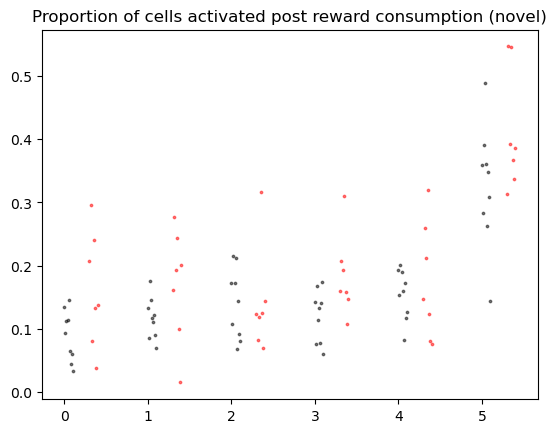

In [90]:
fig, ax = plt.subplots()
for day in range(6):
    ax.scatter(day + np.linspace(0,.1,num=len(ctrl_mice)), prop_reactive['ctrl'][day,:], color='black', s=3, alpha=.5)
    ax.scatter(day + np.linspace(.3,.4,num=len(ko_mice)), prop_reactive['cre'][day, :], color='red', s=3, alpha=.5)

ax.set_title("Proportion of cells activated post reward consumption (novel)")

In [8]:
prop_reactive = {'ctrl':np.nan*np.zeros((6,len(ctrl_mice))), 'cre':np.nan*np.zeros((6,len(ko_mice)))}

for day in range (6):
    for m, mouse in enumerate(ctrl_mice):
        sess = u.load_single_day(mouse,day,verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        
        trial_mask = (sess.timeseries['LR']==-1*sess.novel_arm).ravel()
        prop_reactive['ctrl'][day, m] = (1*(post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]

    for m, mouse in enumerate(ko_mice):
        sess = u.load_single_day(mouse,day, verbose=False)
        _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        
        trial_mask = (sess.timeseries['LR']==-1*sess.novel_arm).ravel()
        prop_reactive['cre'][day, m] = (1*(post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1)).sum()/sess.timeseries['spks'].shape[0]

KeyboardInterrupt: 

In [ ]:
fig, ax = plt.subplots()
for day in range(6):
    ax.scatter(day + np.linspace(0,.1,num=len(ctrl_mice)), prop_reactive['ctrl'][day,:], color='black', s=3, alpha=.5)
    ax.scatter(day + np.linspace(.3,.4,num=len(ko_mice)), prop_reactive['cre'][day, :], color='red', s=3, alpha=.5)

ax.set_title("Proportion of cells activated post reward consumption (familiar)")

In [57]:
# find cells activated during rest in novel trials (repeat for familiar trials)
# plot average activity level in familiar vs novel environments


act_diff_dict = {}

for d in range(6):
    act_diff_dict[d] = {}
    for k, mice in zip(('ctrl', 'cre'),(ctrl_mice, ko_mice)):
        act_diff_dict[d][k]={}
        act_diff_mu = np.zeros((len(mice),2))
        # fig, ax = plt.subplots(len(mice),1)
        for m, mouse in enumerate(mice):
            sess = u.load_single_day(mouse,d, verbose=False)
            _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
            for t, (tk, trial_type) in enumerate(zip(('fam', 'nov'),(-1,1))):
                
                # restrict this to the last block of trials 
                trial_mask = (sess.timeseries['LR']==trial_type*sess.novel_arm).ravel()

                activated_cells = post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1

                act = nov_act = sess.trial_matrices['spks_norm'][:,:,activated_cells]
                # nov_act = np.nanmean(act[sess.trial_info['LR']==sess.novel_arm,:,:],axis=0)
                # fam_act = np.nanmean(act[sess.trial_info['LR']==-1*sess.novel_arm,:,:],axis=0)
                nov_act = np.nanmean(np.nanmean(act[sess.trial_info['LR']==sess.novel_arm,:,:],axis=0),axis=0)
                fam_act = np.nanmean(np.nanmean(act[sess.trial_info['LR']==-1*sess.novel_arm,:,:],axis=0),axis=0)
                # act_diff = np.nanmean(nov_act-fam_act,axis=0)
                act_diff = np.nanmean(nov_act-fam_act,axis=0)

                act_diff_mu[m,t] = act_diff.mean()


            # ax[m].hist(act_diff, np.linspace(-.015,.015,num=20),density=True)

        act_diff_dict[d][k]['fam'] = act_diff_mu[:,0]
        act_diff_dict[d][k]['nov'] = act_diff_mu[:,1]
        



# sess.trial_matrices['spks

30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

In [71]:
sess.trial_info.keys()

dict_keys(['block_number', 'LR'])

In [58]:
df = {'mouse':[], 'ctrl/cre':[], 'fam/nov': [], 'act_diff': [], 'day':[]} 
for d in range(6):
    for k, (ko_key, mice) in enumerate(zip(('ctrl', 'cre'),(ctrl_mice, ko_mice))):
        for m, mouse in enumerate(mice):
            for t, (tk, trial_type) in enumerate(zip(('fam', 'nov'),(-1,1))):
                df['mouse'].append(mouse)
                df['ctrl/cre'].append(ko_key)
                df['fam/nov'].append(tk)
                df['day'].append(d)
                df['act_diff'].append(act_diff_dict[d][ko_key][tk][m])
df = pd.DataFrame(df)

In [64]:
aov = mixed_anova(data=df[df['fam/nov']=='fam'], dv='act_diff', between='ctrl/cre', within='day', subject='mouse')

/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in double_scalars
  W = np.product(eig) / (eig.sum() / d) ** d


In [65]:
print(aov)

        Source        SS  DF1  DF2        MS         F         p-unc  \
0     ctrl/cre  0.000483    1   14  0.000483  3.574234  7.956192e-02   
1          day  0.001548    5   70  0.000310  9.624260  5.050012e-07   
2  Interaction  0.000466    5   70  0.000093  2.894416  1.966585e-02   

        np2       eps  
0  0.203379       NaN  
1  0.407389  0.612828  
2  0.171324       NaN  


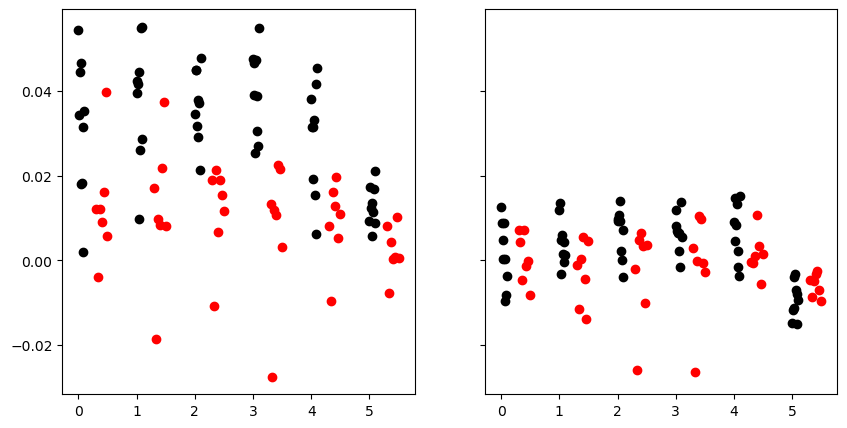

In [63]:
fig, ax = plt.subplots(1,2,sharey=True, figsize=[10,5])
fig.subplots_adjust(wspace=.2)
for day in range(6):

    ax[0].scatter(day + np.linspace(0,.1,num=len(ctrl_mice)),act_diff_dict[day]['ctrl']['nov'][:],color='black')
    ax[0].scatter(day+ np.linspace(.3,.5,num=len(ko_mice)),act_diff_dict[day]['cre']['nov'][:],color='red')
    
    ax[1].scatter(day + np.linspace(0,.1,num=len(ctrl_mice)),act_diff_dict[day]['ctrl']['fam'][:],color='black')
    ax[1].scatter(day+ np.linspace(.3,.5,num=len(ko_mice)),act_diff_dict[day]['cre']['fam'][:],color='red')
    # ax.plot(act_diff_mu)

In [ ]:
# find cells that are reactivated

# find difference in activity rate between reactivated and non-reactivated cells for familiar vs novel 

# spatial information of reactivated vs non-reactivated cells

# trial x trial correlation




In [6]:
df = {'mouse':[], 'ctrl/cre':[], 'fam/nov': [], 'act_diff': [], 'day':[]} 


for d in range(6):
    for ko_key, mice in zip(('ctrl', 'cre'), (ctrl_mice, ko_mice)):
        for m, mouse in enumerate(mice):
            
            sess = u.load_single_day(mouse,d, verbose=False)
            _, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
            
            for t, (t_key, trial_type) in enumerate(zip(('fam', 'nov'), (-1, 1))):
                
                trial_mask = (sess.timeseries['LR']==trial_type*sess.novel_arm).ravel()

                activated_cells = post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1

                act = sess.trial_matrices['spks_norm'][:,:,activated_cells]
                act = np.log(np.nanmean(np.nanmean(act[sess.trial_info['LR'] == trial_type*sess.novel_arm, :], axis=0), axis=0))
                
                
                non_act = sess.trial_matrices['spks_norm'][:,:,~activated_cells]
                non_act = np.log(np.nanmean(np.nanmean(non_act[sess.trial_info['LR'] == trial_type*sess.novel_arm, :], axis=0), axis=0))
                
                
                df['mouse'].append(mouse)
                df['ctrl/cre'].append(ko_key)
                df['fam/nov'].append(t_key)
                df['day'].append(d)
                df['act_diff'].append(act.mean()-non_act.mean())
                


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUti

In [9]:
df = pd.DataFrame(df)
aov = mixed_anova(data=df[df['fam/nov']=='nov'], dv='act_diff', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.160620    1   14  0.160620  9.468493  0.008197  0.403456   
1          day  0.142561    5   70  0.028512  5.691448  0.000184  0.289031   
2  Interaction  0.003010    5   70  0.000602  0.120184  0.987491  0.008511   

       eps  
0      NaN  
1  0.69066  
2      NaN  


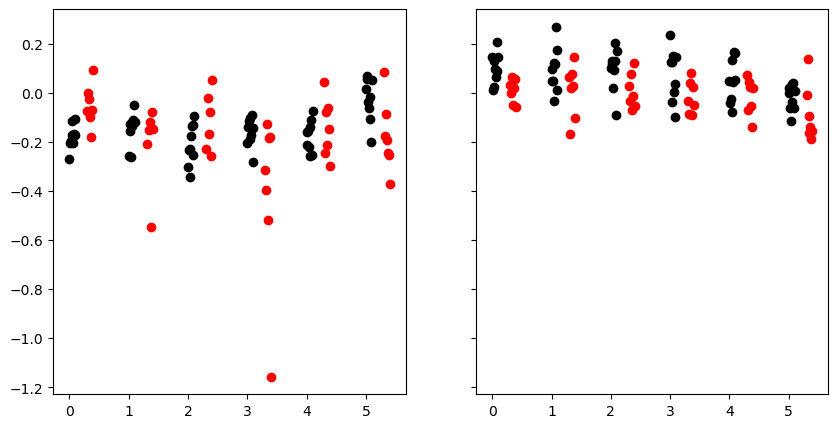

In [8]:
fig, ax = plt.subplots(1,2, figsize=[10,5], sharey=True)

for d in range(6):
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='ctrl')]
    ax[0].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['act_diff'], color='black')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='cre')]
    ax[0].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['act_diff'], color='red')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='ctrl')]
    ax[1].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['act_diff'], color='black')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='cre')]
    ax[1].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['act_diff'], color='red')

In [10]:
df = {'mouse':[], 'ctrl/cre':[], 'fam/nov': [], 'act_diff': [], 'day':[]} 


for d in range(6):
    for ko_key, mice in zip(('ctrl', 'cre'), (ctrl_mice, ko_mice)):
        for m, mouse in enumerate(mice):
            
            sess = u.load_single_day(mouse,d, verbose=False)
            spks, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
            
            for t, (t_key, trial_type) in enumerate(zip(('fam', 'nov'), (-1, 1))):
                tstarts = sess.trial_start_inds[sess.trial_info['LR']==trial_type*sess.novel_arm]
                teleports = sess.teleport_inds[sess.trial_info['LR']==trial_type*sess.novel_arm]
                post_reward_reactivation_mask, non_reactivation_mask = get_post_reward_reactivation_masks(spks, tstarts, teleports, post_reward_activation_mask, trial_activation_mask)
                reactivated_trial_mask = 1*(np.cumsum(post_reward_reactivation_mask, axis=-1)>0)
                first_post_reward_reactivation_mask = np.diff(reactivated_trial_mask[:,:-1], prepend=0,axis=-1)
                first_react = np.argwhere(first_post_reward_reactivation_mask==1)
                
                post_react_trial_act = np.zeros((first_react.shape[0],))
                pre_react_trial_act = np.zeros((first_react.shape[0],))

                for i, react in enumerate(first_react):
                    cell, trial = react[0], react[1]
                    post_react_trial_act[i] = np.nanmean(np.nanmean(sess.trial_matrices['spks_norm'][trial+1:,:,cell],axis=-1))
                    pre_react_trial_act[i] = np.nanmean(np.nanmean(sess.trial_matrices['spks_norm'][:trial,:,cell],axis=-1))
                
                mask = np.isnan(pre_react_trial_act)  + np.isnan(post_react_trial_act) 
                    
                df['mouse'].append(mouse)
                df['ctrl/cre'].append(ko_key)
                df['fam/nov'].append(t_key)
                df['day'].append(d)
                df['act_diff'].append(post_react_trial_act[~mask].mean()-pre_react_trial_act[~mask].mean())
                

/tmp/ipykernel_2267229/2502054071.py:25: RuntimeWarning: Mean of empty slice
  pre_react_trial_act[i] = np.nanmean(np.nanmean(sess.trial_matrices['spks_norm'][:trial,:,cell],axis=-1))
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel


/tmp/ipykernel_2267229/2502054071.py:25: RuntimeWarning: Mean of empty slice
  pre_react_trial_act[i] = np.nanmean(np.nanmean(sess.trial_matrices['spks_norm'][:trial,:,cell],axis=-1))
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at 

02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel


/tmp/ipykernel_2267229/2502054071.py:25: RuntimeWarning: Mean of empty slice
  pre_react_trial_act[i] = np.nanmean(np.nanmean(sess.trial_matrices['spks_norm'][:trial,:,cell],axis=-1))
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at 

In [11]:
df = pd.DataFrame(df)
aov = mixed_anova(data=df[df['fam/nov']=='nov'], dv='act_diff', between='ctrl/cre', within='day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS         F     p-unc       np2  \
0     ctrl/cre  0.000006    1   14  0.000006  0.016534  0.899515  0.001180   
1          day  0.000524    5   70  0.000105  0.641693  0.668641  0.043826   
2  Interaction  0.000140    5   70  0.000028  0.171904  0.972186  0.012130   

        eps  
0       NaN  
1  0.409424  
2       NaN  


/home/mplitt/mambaforge/envs/STX3/lib/python3.8/site-packages/pingouin/distribution.py:1006: RuntimeWarning: divide by zero encountered in double_scalars
  W = np.product(eig) / (eig.sum() / d) ** d


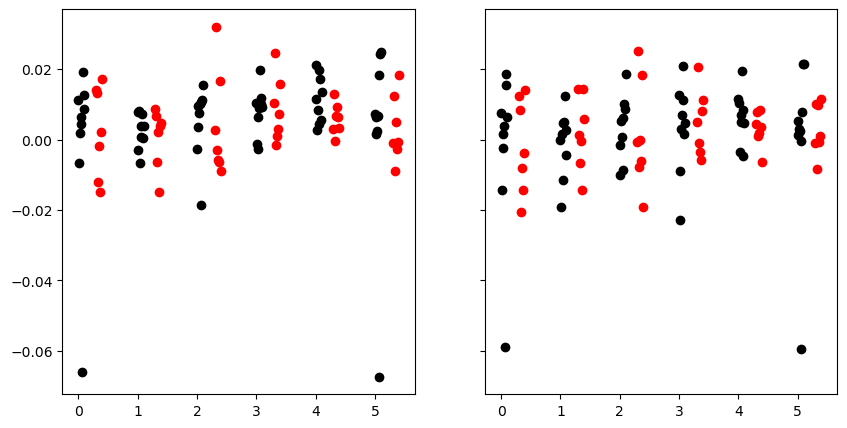

In [12]:
fig, ax = plt.subplots(1,2, figsize=[10,5], sharey=True)

for d in range(6):
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='ctrl')]
    ax[0].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['act_diff'], color='black')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='cre')]
    ax[0].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['act_diff'], color='red')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='ctrl')]
    ax[1].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['act_diff'], color='black')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='cre')]
    ax[1].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['act_diff'], color='red')


In [30]:
# trial x trial correlation
sess.timeseries.keys()

dict_keys(['F', 'Fneu', 'spks', 'F_dff', 'F_dff_norm', 'spks_norm', 'licks', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward', 'block_number'])

In [95]:
df = {'mouse':[], 'ctrl/cre':[], 'fam/nov': [], 'corr_diff': [], 'day':[]} 


for d in range(6):
    for ko_key, mice in zip(('ctrl', 'cre'), (ctrl_mice, ko_mice)):
        for m, mouse in enumerate(mice):
            
            sess = u.load_single_day(mouse,d, verbose=False)
            spks, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
            
            tmat_z = sp.stats.zscore(sess.trial_matrices['spks'],axis=0, nan_policy='omit')
            tmat_z[np.isnan(tmat_z)]=0

            corr = 1/tmat_z.shape[1]*np.matmul(np.transpose(tmat_z, axes=(2,0,1)), np.transpose(tmat_z, axes=(2,1,0)))
            corr = np.maximum(np.minimum(corr,1-1E-5),-1+1E-5)
            
            tstarts = sess.trial_start_inds
            teleports = sess.teleport_inds
            post_reward_reactivation_mask, non_reactivation_mask = get_post_reward_reactivation_masks(spks, tstarts, teleports, post_reward_activation_mask, trial_activation_mask)
            
            for t, (t_key, trial_type) in enumerate(zip(('fam', 'nov'), (-1, 1))):
                

                trial_mask = ((sess.timeseries['LR']==trial_type*sess.novel_arm)*(sess.timeseries['block_number']==5)).ravel()

                activated_cells = post_reward_activation_mask[:,trial_mask].sum(axis=-1)>1
                
                trial_mask = (sess.trial_info['LR']==trial_type*sess.novel_arm)*(sess.trial_info['block_number']==5)
                avg_corr = np.nanmean(np.nanmean(np.arctanh(corr[:, trial_mask, :][:, :, trial_mask]), axis=-1), axis=-1)
                
                df['mouse'].append(mouse)
                df['ctrl/cre'].append(ko_key)
                df['fam/nov'].append(t_key)
                df['day'].append(d)
                df['corr_diff'].append(np.nanmean(avg_corr[activated_cells]) - np.nanmean(avg_corr[~activated_cells]))
                


/tmp/ipykernel_2267719/3764891234.py:35: RuntimeWarning: Mean of empty slice
  df['corr_diff'].append(np.nanmean(avg_corr[activated_cells]) - np.nanmean(avg_corr[~activated_cells]))


KeyboardInterrupt: 

In [ ]:
df = pd.DataFrame(df)
aov = mixed_anova(data=df[df['fam/nov']=='fam'], dv='corr_diff', between='ctrl/cre', within='day', subject='mouse')
print(aov)

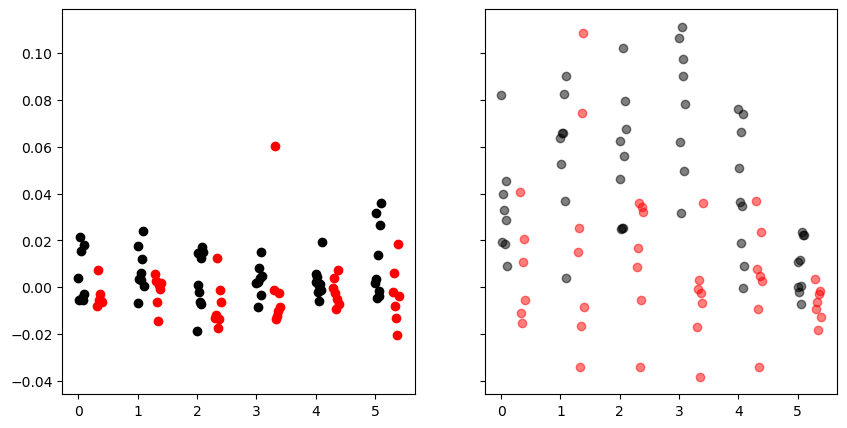

In [93]:
fig, ax = plt.subplots(1,2, figsize=[10,5], sharey=True)

for d in range(6):
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='ctrl')]
    ax[0].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['corr_diff'], color='black')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='fam')*(df['ctrl/cre']=='cre')]
    ax[0].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['corr_diff'], color='red')
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='ctrl')]
    ax[1].scatter(d+ np.linspace(0,.1,num=dat.shape[0]), dat['corr_diff'], color='black', alpha=.5)
    
    dat = df[(df['day']==d)*(df['fam/nov']=='nov')*(df['ctrl/cre']=='cre')]
    ax[1].scatter(d+ np.linspace(.3,.4,num=dat.shape[0]), dat['corr_diff'], color='red', alpha=.5)

In [79]:
# find activated cells and see if they're more stable on subsequent days compared to non-reactivated cells

sess = u.single_mouse_concat_sessions(ctrl_mice[1], date_inds = np.arange(6), load_stats=False)


29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel


In [61]:
df = {'mouse':[], 'ctrl/cre':[], 'fam/nov': [], 'corr_diff': [], 'curr_day':[], 'fut_day':[], 'day_diff':[]} 

plot_dict = {}
for ko_key, mice in zip(('ctrl','cre'), (ctrl_mice, ko_mice)):
    plot_dict[ko_key] = {}
    for m, mouse in enumerate(mice):
        plot_dict[ko_key][mouse] = {}
        sess = u.single_mouse_concat_sessions(mouse, date_inds = np.arange(6), load_stats=False)
        
        # get reactivated cells in novel (or fam) trials
        tstarts = sess.trial_start_inds
        teleports = sess.teleport_inds
        spks, _, reactivation_mask, post_reward_activation_mask, trial_activation_mask = get_activation_masks(sess)
        post_reward_reactivation_mask, non_reactivation_mask = get_post_reward_reactivation_masks(spks, tstarts, teleports, post_reward_activation_mask, trial_activation_mask)
        
        for t_key, t_type in zip(('fam','nov'),(-1, 1)):
            plot_dict[ko_key][mouse][t_key] = {}
            for curr_day in range(5):
            
                plot_dict[ko_key][mouse][t_key][curr_day] = {}
                # get novel trials
                curr_nov_trials = (sess.trial_info['sess_num']==curr_day)*(sess.trial_info['LR']==t_type*sess.novel_arm)

                curr_act_cells = post_reward_reactivation_mask[:,curr_nov_trials].sum(axis=-1)>0
    

                # get average rate map on reactivated day
                curr_tmat = sp.stats.zscore(np.nanmean(sess.trial_matrices['spks'][curr_nov_trials,:,:],axis=0),axis=0)
                curr_tmat = curr_tmat[np.newaxis, :, :]

                # get average rate map on subsequent days
                fut_tmat = np.zeros((6, *curr_tmat.shape[1:]))
                for fut_day in np.arange(curr_day,6):
                    fut_nov_trials =  (sess.trial_info['sess_num']==fut_day)*(sess.trial_info['LR']==t_type*sess.novel_arm)
                    fut_tmat[fut_day, :, :] = sp.stats.zscore(np.nanmean(sess.trial_matrices['spks'][fut_nov_trials, :, :], axis=0),axis=0)

                curr_tmat[np.isnan(curr_tmat)]=0
                fut_tmat[np.isnan(fut_tmat)]=0

                # correlate current and future
                curr_fut_corr_mat = 1./curr_tmat.shape[1]*np.matmul(np.transpose(curr_tmat, axes=(0,2,1)), fut_tmat)
                curr_fut_corr = np.maximum(np.minimum(np.array([np.diagonal(curr_fut_corr_mat[d,:,:]) for d in range(6)]),1-1E-5),-1+1E-5)

                # compare reactivated and non-reactivated
                curr_diff = np.nanmean(np.arctanh(curr_fut_corr[:,curr_act_cells]), axis=-1) - np.nanmean(np.arctanh(curr_fut_corr[:,~curr_act_cells]), axis=-1)

                plot_dict[ko_key][mouse][t_key][curr_day]['act_corr'] = curr_fut_corr[:,curr_act_cells]
                plot_dict[ko_key][mouse][t_key][curr_day]['nonact_corr'] = curr_fut_corr[:,~curr_act_cells]
                plot_dict[ko_key][mouse][t_key][curr_day]['corr_diff'] = np.nanmean(np.arctanh(curr_fut_corr[:,curr_act_cells]), axis=-1) - np.nanmean(np.arctanh(curr_fut_corr[:,~curr_act_cells]), axis=-1)
                
                for fut_day in range(curr_day, 6):
                    df['mouse'].append(mouse)
                    df['ctrl/cre'].append(ko_key)
                    df['fam/nov'].append(t_key)
                    df['curr_day'].append(curr_day)
                    df['fut_day'].append(fut_day)
                    df['corr_diff'].append(curr_diff[fut_day])
                    df['day_diff'].append(fut_day-curr_day)











29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel
04_12_2020 YMaze_LNovel
29_11_2020 YMaze_LNovel
30_11_2020 YMaze_LNovel
01_12_2020 YMaze_LNovel
02_12_2020 YMaze_LNovel
03_12_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /media/mplitt/Backup Plus3/2P_Data/4467333.1/05_12_2020/YMaze_LNovel/YMaze_LNovel_001_002.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


05_12_2020 YMaze_LNovel
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
14_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
15_10_2021 YMaze_LNovel
16_10_2021 YMaze_LNovel
17_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.1/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_003.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/30_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/01_10_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


01_10_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/02_10_2020/YMaze_LNovel/YMaze_LNovel_001_009.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


02_10_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.2/03_10_2020/YMaze_LNovel/YMaze_LNovel_001_008.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


03_10_2020 YMaze_LNovel


/tmp/ipykernel_2270069/3394017461.py:45: RuntimeWarning: Mean of empty slice
  curr_diff = np.nanmean(np.arctanh(curr_fut_corr[:,curr_act_cells]), axis=-1) - np.nanmean(np.arctanh(curr_fut_corr[:,~curr_act_cells]), axis=-1)
/tmp/ipykernel_2270069/3394017461.py:49: RuntimeWarning: Mean of empty slice
  plot_dict[ko_key][mouse][t_key][curr_day]['corr_diff'] = np.nanmean(np.arctanh(curr_fut_corr[:,curr_act_cells]), axis=-1) - np.nanmean(np.arctanh(curr_fut_corr[:,~curr_act_cells]), axis=-1)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


28_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/29_09_2020/YMaze_LNovel/YMaze_LNovel_001_004.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


29_09_2020 YMaze_LNovel


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:229: UserWarning: Could not find sbxmat file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.mat
  warnings.warn("Could not find sbxmat file at %s" % self.scanheader_file)
/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:238: UserWarning: Could not find sbx file at /mnt/BigDisk/2P_scratch/4467975.3/30_09_2020/YMaze_LNovel/YMaze_LNovel_002_007.sbx
  warnings.warn("Could not find sbx file at %s" % self.scan_file)


30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
28_09_2020 YMaze_LNovel
29_09_2020 YMaze_LNovel
30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
28_09_2020 YMaze_LNovel
29_09_2020 YMaze_LNovel
30_09_2020 YMaze_LNovel
01_10_2020 YMaze_LNovel
02_10_2020 YMaze_LNovel
03_10_2020 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel
22_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel
18_10_2021 YMaze_LNovel
19_10_2021 YMaze_LNovel
20_10_2021 YMaze_LNovel
21_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel
23_10_2021 YMaze_LNovel


In [54]:
df = pd.DataFrame(df)
# df
mask = (df['day_diff']==1)*(df['fam/nov']=='fam')
# df[mask]

aov = mixed_anova(data=df[mask], dv='corr_diff', between='ctrl/cre', within='curr_day', subject='mouse')
print(aov)

        Source        SS  DF1  DF2        MS          F     p-unc       np2  \
0     ctrl/cre  0.121373    1   14  0.121373  11.414678  0.004501  0.449137   
1     curr_day  0.025297    4   56  0.006324   0.402957  0.805710  0.027977   
2  Interaction  0.049543    4   56  0.012386   0.789166  0.537128  0.053361   

        eps  
0       NaN  
1  0.753785  
2       NaN  


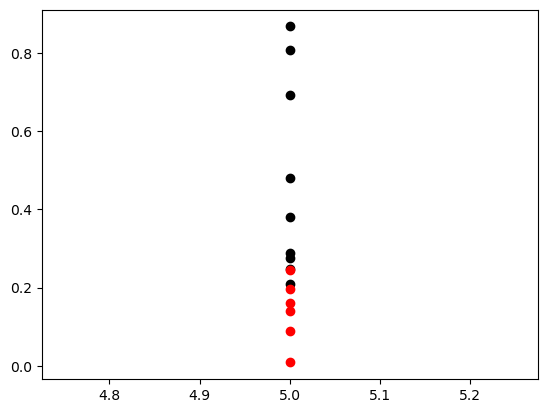

In [96]:
fig, ax = plt.subplots()
for ko_key, mice, plot_color in zip(('ctrl','cre'), (ctrl_mice, ko_mice),('black','red')):
    for m, mouse in enumerate(mice):
        t_key = 'nov'
        curr_day=4
        # for t_key, t_type in zip(('fam','nov'),(-1, 1)):
            
            # for curr_day in range(5):
        diff = plot_dict[ko_key][mouse][t_key][curr_day]['corr_diff']
        ax.scatter(np.arange(curr_day+1,6),diff[curr_day+1:], color=plot_color)
        

0.0
0.0
0.0
2.220446049250313e-16
0.03361505565760625


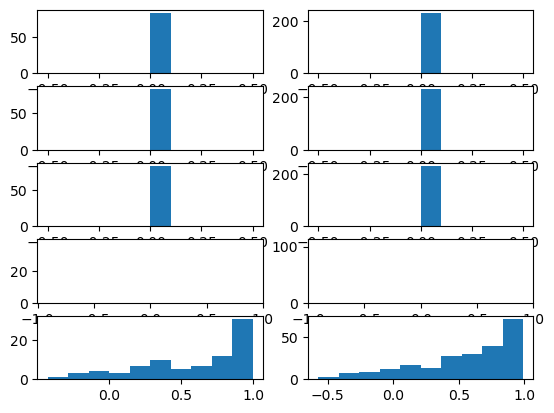

In [87]:
fig, ax = plt.subplots(5,2)
for d in range(5):
    _ = ax[d,0].hist(curr_fut_corr[d+1,curr_act_cells])
    _ = ax[d,1].hist(curr_fut_corr[d+1,~curr_act_cells])
    print(np.tanh(curr_fut_corr[d+1,curr_act_cells]).mean() - np.tanh(curr_fut_corr[d+1,~curr_act_cells]).mean())
    


In [82]:
print(curr_fut_corr[curr_act_cells].mean(),curr_fut_corr[~curr_act_cells].mean())

IndexError: boolean index did not match indexed array along dimension 0; dimension is 6 but corresponding boolean dimension is 314

In [20]:
corr_act = corr[activated_cells,:,:]
corr_nonact = corr[~activated_cells, :, :]

nov_trial_mask = sess.trial_info['LR']==trial_type*sess.novel_arm
avg_corr = np.nanmean(np.nanmean(corr[:, nov_trial_mask, :][:,:,nov_trial_mask], axis=-1), axis=-1)


In [21]:
print(avg_corr[activated_cells].mean(),avg_corr[~activated_cells].mean())

# fig, ax = plt.

0.2520712936456651 0.16931164328357334


-0.7319976627225613 0.4641699943597949


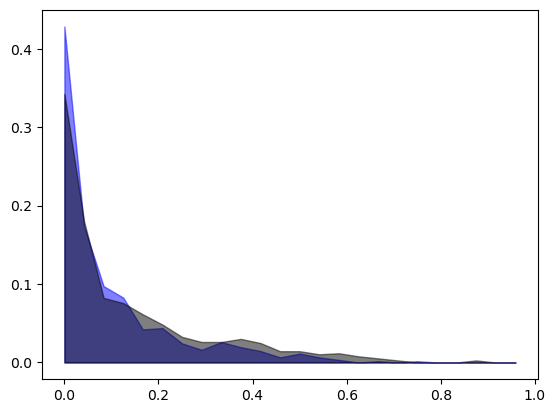

In [62]:
fig,ax = plt.subplots()
bin_edges = np.linspace(0,1,num=25)

act_si, _ = np.histogram(sess.place_cell_info['left']['SI'][activated_cells], bin_edges)
act_si = act_si/act_si.sum()

nonact_si, _ = np.histogram(sess.place_cell_info['left']['SI'][~activated_cells], bin_edges)
nonact_si = nonact_si/nonact_si.sum()

ax.fill_between(bin_edges[:-1], act_si, color='blue', alpha=.5)
ax.fill_between(bin_edges[:-1], nonact_si, color='black', alpha=.5)

t, p = sp.stats.ranksums(act_si, nonact_si)
print(t,p)

NameError: name 'act' is not defined

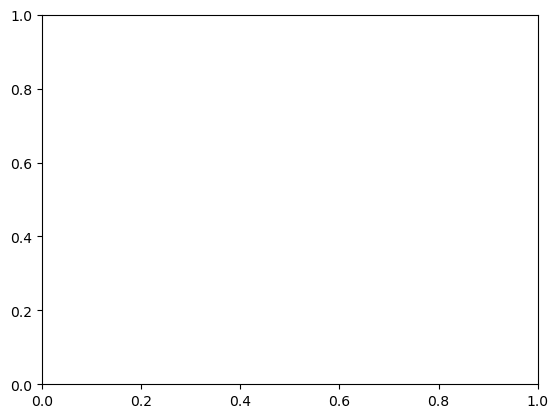

In [99]:
fig, ax = plt.subplots()
bin_edges = np.linspace(-3,0, num=25)
act_hist, _ = np.histogram(act, bin_edges)
act_hist = act_hist/act_hist.sum()
non_act_hist, _ = np.histogram(non_act, bin_edges)
non_act_hist = non_act_hist/non_act_hist.sum()

ax.fill_between(bin_edges[:-1], act_hist, color='blue', alpha=.3)
ax.fill_between(bin_edges[:-1], non_act_hist, color='black', alpha=.3)
# ax.hist(act, bin_edges, color='blue', alpha=.5, density=True)
# ax.hist(non_act, bin_edges, color='black', alpha=.5)

In [ ]:
cell_inds = np.argwhere(activated_cells)
act_inds = np.argwhere(post_reward_activation_mask[cell_inds[0],:]==1)

fig, ax = plt.subplots(3,1,sharex=True)
# print(cell_inds[0][0], act_inds[0][1])
cell = 4
re_ind = 7
window = 200
ax[0].plot(sess.timeseries['spks_norm'][:,act_inds[re_ind][1]-window:act_inds[re_ind][1]+window].mean(axis=0))
ax[1].plot(15.46*sess.timeseries['spks'][cell_inds[cell][0],act_inds[re_ind][1]-window:act_inds[re_ind][1]+window])
ax[1].plot(sess.timeseries['F_dff'][cell_inds[cell][0],act_inds[re_ind][1]-window:act_inds[re_ind][1]+window])
ax[2].plot(sess.timeseries['speed'][0,act_inds[re_ind][1]-window:act_inds[re_ind][1]+window])

In [ ]:
# plot spatial information of reactivated cells vs non-reactivated cells



In [38]:
aoc_react_ctrl = np.zeros([len(ctrl_mice),5,5])
aoc_nonreact_ctrl = np.zeros([len(ctrl_mice),5,5])
for m,mouse in enumerate(ctrl_mice):
    sess = u.load_single_day(mouse,2)
    print(sess.timeseries.keys())
    # reward_react_mask, non_react_mask = reactivation_masks(sess)
    reward_react_mask, non_react_mask = nov_reactivation_masks(sess)
    cum_reward_react_mask = np.cumsum(reward_react_mask,axis=-1)
    
    # pre_reward_bins = sess.trial_matrices['bin_edges'][:-1]<(sess.rzone_fam['tfront']-1)
    pre_reward_bins = sess.trial_matrices['bin_edges'][:-1]<(sess.rzone_nov['tfront']-1)
    
    pre_reward_act = sess.trial_matrices['spks_norm'][sess.trial_info['LR']==sess.novel_arm,:,:] + 1E-5
    pre_reward_act = pre_reward_act[:5,:,:]
    pre_reward_act = pre_reward_act[:,pre_reward_bins,:].sum(axis=1)
    
    for react_trial in range(5):

        # pre_reward_act = sess.trial_matrices['spks_norm'][:20,pre_reward_bins,:].sum(axis=1)+1E-5
        aoc_react = pre_reward_act[:,cum_reward_react_mask[:,react_trial]==1]
        # aoc_react = aoc_react/np.amax(aoc_react,axis=0,keepdims=True)
        print(aoc_react.shape)
        aoc_react_ctrl[m, react_trial,:] =aoc_react.mean(axis=-1)

        aoc_nonreact = pre_reward_act[:,cum_reward_react_mask[:,react_trial]==0]
        # aoc_nonreact = aoc_nonreact/np.amax(aoc_nonreact,axis=0,keepdims=True)
        aoc_nonreact_ctrl[m, react_trial,:] = aoc_nonreact.mean(axis=-1)

        # fig, ax = plt.subplots()
        # ax.plot(aoc_react.mean(axis=-1))
        # ax.plot(aoc_nonreact.mean(axis=-1))

{'date': '01_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': -1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'F_dff', 'spks', 'F_dff_norm', 'spks_norm', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward', 'licks'])
(5, 32)
(5, 47)
(5, 47)
(5, 43)
(5, 47)
{'date': '01_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': 1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'F_dff', 'spks', 'F_dff_norm', 'spks_norm', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward', 'licks'])
(5, 18)
(5, 27)
(5, 36)
(5, 37)
(5, 39)
{'date': '01_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 5, 'novel_arm': -1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'F_dff', 'spks', 'F_dff_norm', 'spks_norm', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward', 'licks'])
(5, 41)
(5, 64)
(5, 81)
(5, 87)
(5, 87)
{'date': '01_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': 1, 'ravel_ind': 4}
dict_keys(['F', 'Fneu', 'F_dff', 'spks', 'F_dff

/tmp/ipykernel_2265388/3893011727.py:23: RuntimeWarning: Mean of empty slice.
  aoc_react_ctrl[m, react_trial,:] =aoc_react.mean(axis=-1)


dict_keys(['F', 'Fneu', 'F_dff', 'spks', 'F_dff_norm', 'spks_norm', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward', 'licks'])
(5, 75)
(5, 67)
(5, 104)
(5, 99)
(5, 92)
{'date': '16_10_2021', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2, 'novel_arm': 1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'spks', 'F_dff', 'F_dff_norm', 'spks_norm', 'licks', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward'])
(5, 6)
(5, 23)
(5, 31)
(5, 31)
(5, 31)
{'date': '16_10_2021', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3, 'novel_arm': -1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'spks', 'F_dff', 'F_dff_norm', 'spks_norm', 'licks', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward'])
(5, 16)
(5, 13)
(5, 17)
(5, 19)
(5, 25)
{'date': '16_10_2021', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2, 'novel_arm': 1, 'ravel_ind': 2}
dict_keys(['F', 'Fneu', 'spks', 'F_dff', 'F_dff_norm', 'spks_norm', 'licks', 'speed', 'spks_norm_fast', 't', 'spks_th', 'LR', 'reward'])
(5, 18)
(5, 25)


In [39]:
aoc_react_ko = np.zeros([len(ko_mice),5,5])
aoc_nonreact_ko = np.zeros([len(ko_mice),5,5])
for m,mouse in enumerate(ko_mice):
    sess = u.load_single_day(mouse,2)
    # reward_react_mask, non_react_mask = reactivation_masks(sess)
    reward_react_mask, non_react_mask = nov_reactivation_masks(sess)
    cum_reward_react_mask = np.cumsum(reward_react_mask,axis=-1)
    
    # pre_reward_bins = sess.trial_matrices['bin_edges'][:-1]<(sess.rzone_fam['tfront']-1)
    pre_reward_bins = sess.trial_matrices['bin_edges'][:-1]<(sess.rzone_nov['tfront']-1)
    
    pre_reward_act = sess.trial_matrices['spks_norm'][sess.trial_info['LR']==sess.novel_arm,:,:] + 1E-5
    pre_reward_act = pre_reward_act[:5,:,:]
    pre_reward_act = pre_reward_act[:,pre_reward_bins,:].sum(axis=1)
    
    for react_trial in range(5):

        # pre_reward_act = sess.trial_matrices['spks_norm'][:20,pre_reward_bins,:].sum(axis=1)+1E-5
        aoc_react = pre_reward_act[:,cum_reward_react_mask[:,react_trial]==1]
        # aoc_react = aoc_react/np.amax(aoc_react,axis=0,keepdims=True)
        print(aoc_react.shape)
        aoc_react_ko[m, react_trial,:] =aoc_react.mean(axis=-1)

        aoc_nonreact = pre_reward_act[:,cum_reward_react_mask[:,react_trial]==0]
        # aoc_nonreact = aoc_nonreact/np.amax(aoc_nonreact,axis=0,keepdims=True)
        aoc_nonreact_ko[m, react_trial,:] = aoc_nonreact.mean(axis=-1)

{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': -1, 'ravel_ind': 3}
(5, 15)
(5, 20)
(5, 24)
(5, 41)
(5, 45)
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': 1, 'ravel_ind': 2}
(5, 8)
(5, 15)
(5, 17)
(5, 22)
(5, 19)
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 2, 'scan': 7, 'novel_arm': -1, 'ravel_ind': 2}
(5, 0)
(5, 102)
(5, 148)
(5, 169)
(5, 178)
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3, 'novel_arm': 1, 'ravel_ind': 2}


/tmp/ipykernel_2265388/1319003336.py:22: RuntimeWarning: Mean of empty slice.
  aoc_react_ko[m, react_trial,:] =aoc_react.mean(axis=-1)


(5, 76)
(5, 76)
(5, 92)
(5, 108)
(5, 121)
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 5, 'novel_arm': -1, 'ravel_ind': 2}
(5, 78)
(5, 140)
(5, 155)
(5, 181)
(5, 181)
{'date': '20_10_2021', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 1, 'novel_arm': -1, 'ravel_ind': 2}
(5, 2)
(5, 8)
(5, 9)
(5, 11)
(5, 21)
{'date': '20_10_2021', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4, 'novel_arm': 1, 'ravel_ind': 2}
(5, 38)
(5, 42)
(5, 65)
(5, 83)
(5, 81)


In [40]:

print(aoc_nonreact_ctrl.shape)

(9, 5, 5)


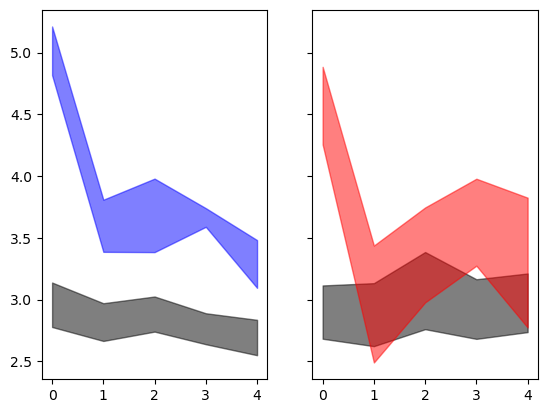

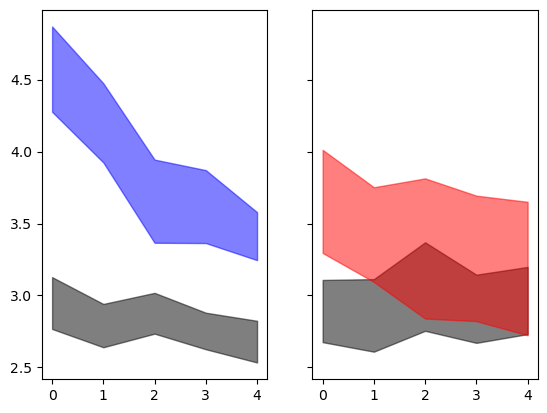

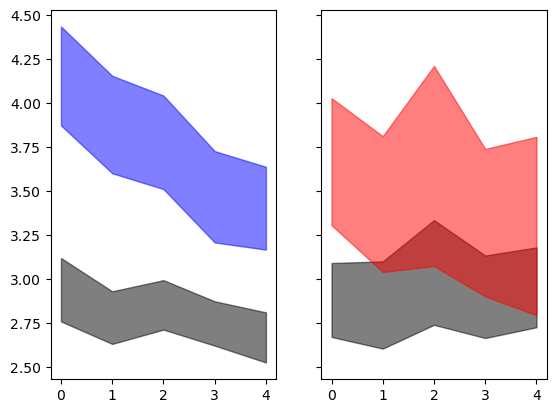

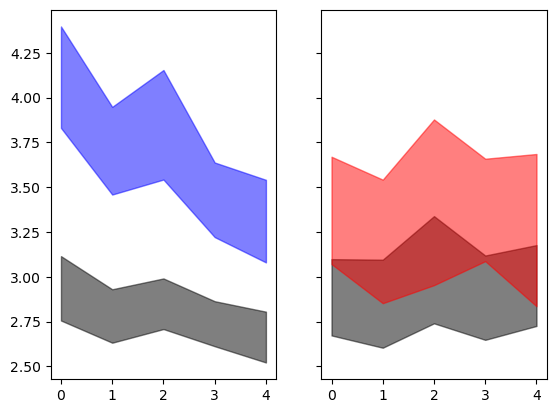

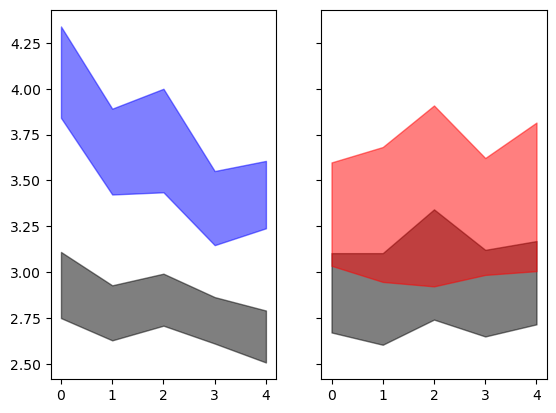

In [41]:
for i in range(5):
    fig, ax = plt.subplots(1,2,sharey=True, sharex=True)
    mu, sem = np.nanmean(aoc_nonreact_ctrl[:,i,:],axis=0), sp.stats.sem(aoc_nonreact_ctrl[:,i,:],axis=0,nan_policy='omit')
    ax[0].fill_between(np.arange(5),mu-sem, mu+sem, color='black', alpha=.5)
    mu, sem = np.nanmean(aoc_nonreact_ko[:,i,:],axis=0), sp.stats.sem(aoc_nonreact_ko[:,i,:],axis=0,nan_policy='omit')
    ax[1].fill_between(np.arange(5),mu-sem, mu+sem, color='black', alpha=.5)
    
    mu, sem = np.nanmean(aoc_react_ctrl[:,i,:],axis=0), sp.stats.sem(aoc_react_ctrl[:,i,:],axis=0,nan_policy='omit')
    ax[0].fill_between(np.arange(5),mu-sem, mu+sem, color='blue', alpha=.5)
    mu, sem = np.nanmean(aoc_react_ko[:,i,:],axis=0), sp.stats.sem(aoc_react_ko[:,i,:],axis=0,nan_policy='omit')
    ax[1].fill_between(np.arange(5),mu-sem, mu+sem, color='red', alpha=.5)

In [ ]:
for t, (start,stop) in enumerate(zip(sess.trial_start_inds.to_list(),sess.teleport_inds.to_list())):
    
    if t<20:
        fig,ax = plt.subplots(3,1, sharex=True)

        x = np.arange(start,stop)-start
        ax[0].imshow(spks[:,start:stop],aspect='auto', vmin=0, vmax=.005)

        ax[1].plot(x, pop_stat_z[start:stop]) #(spks_ledge_smooth[:,start:stop]).sum(axis=0)/spks.shape[0])
        # ax[1].set_ylim([-3,5])
        ax[1].plot(x, 2*np.ones(x.shape),color='green',alpha=.5)
        

        ax[2].plot(x,speed[start:stop])
        ax[2].plot(x,40*post_reward_bool[start:stop])

In [ ]:
# sess.rzone_fam?
pre_reward_bins = sess.trial_matrices['bin_edges'][:-1]<(sess.rzone_fam['tfront']-1)


In [38]:
post_reward_reactivation_mask.shape

(1283, 140)

In [39]:

cum_post_reward_reactivation_mask = np.cumsum(post_reward_reactivation_mask,axis=-1)

In [40]:
cum_post_reward_reactivation_mask[:,0]

array([0., 0., 0., ..., 0., 0., 0.])

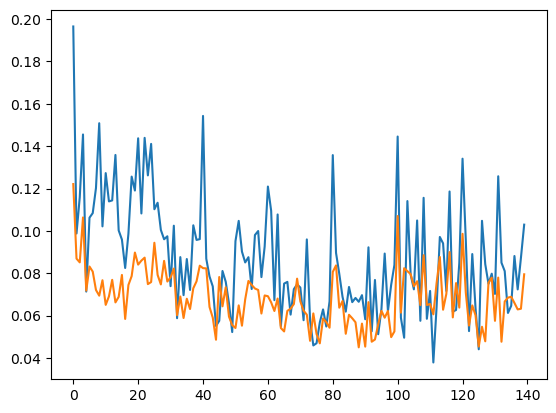

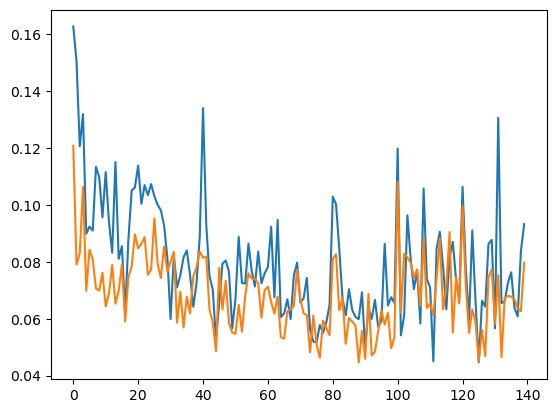

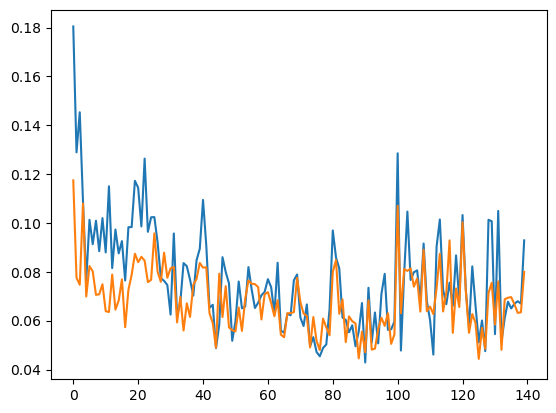

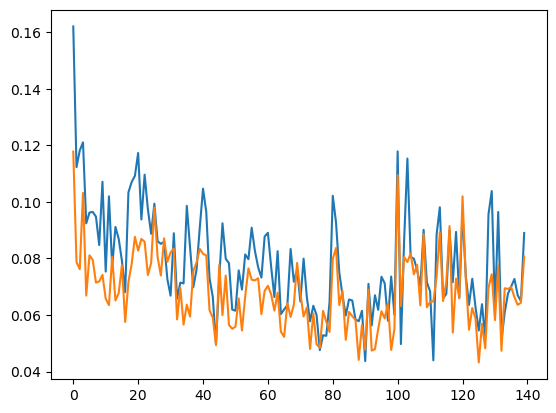

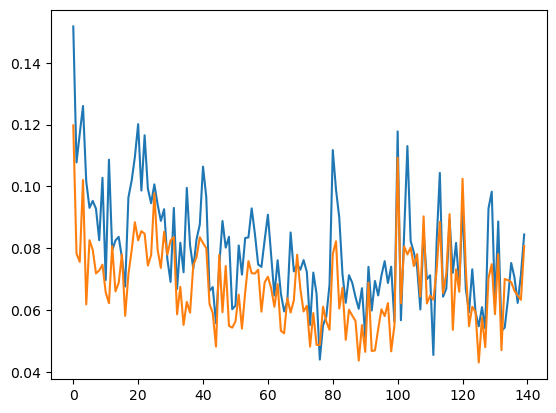

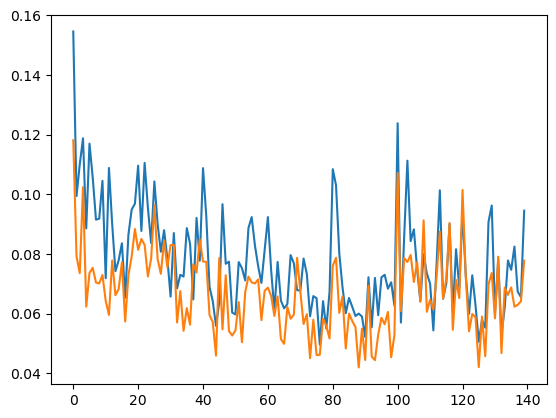

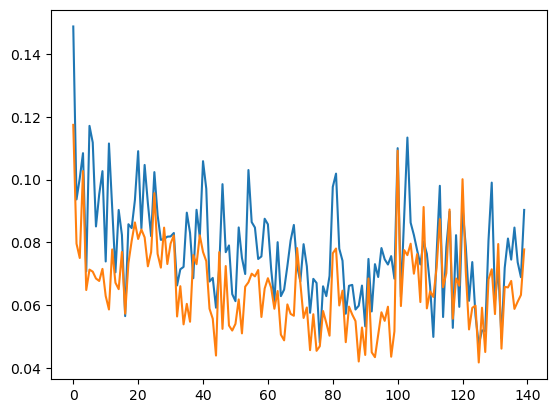

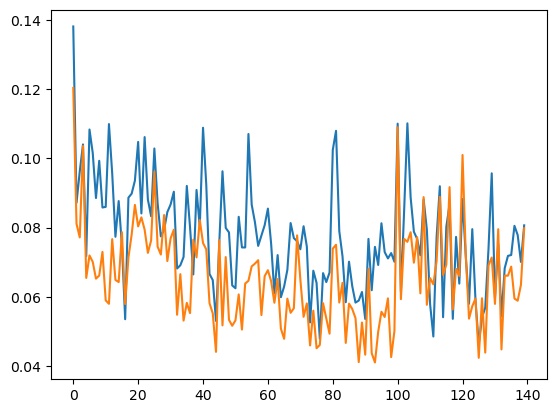

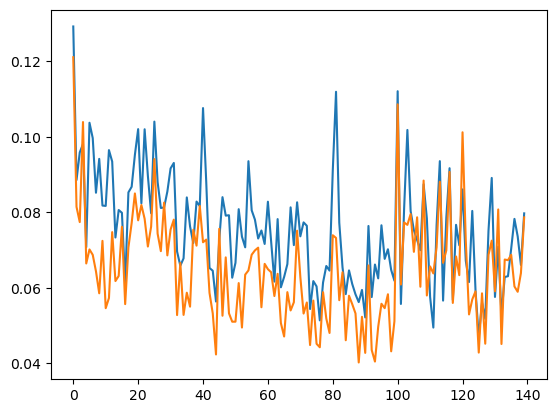

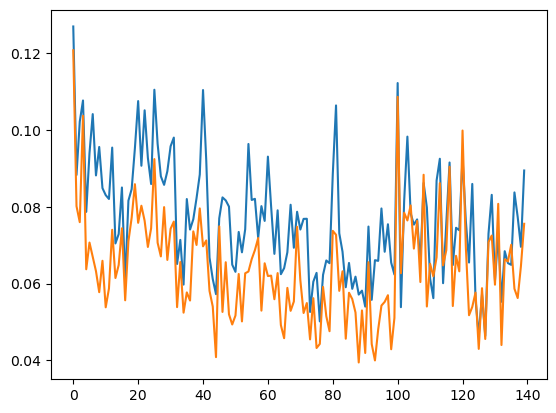

In [41]:
# cells = np.argwhere(post_reward_reactivation_mask[:,0]>0)

# tmp = sess.

for react_trial in range(5):

    pre_reward_act = sess.trial_matrices['spks_th'][:,pre_reward_bins,:].sum(axis=1)+1E-5
    aoc_react = pre_reward_act[:,cum_post_reward_reactivation_mask[:,react_trial]==1]
    aoc_react = aoc_react/np.amax(aoc_react,axis=0,keepdims=True)

    # aoc_nonreact = pre_reward_act[:,(non_reactivation_mask[:,react_trial]==1)|(cum_post_reward_reactivation_mask[:,react_trial]>1)]
    aoc_nonreact = pre_reward_act[:,non_reactivation_mask[:,react_trial]==1]
    aoc_nonreact = pre_reward_act[:,cum_post_reward_reactivation_mask[:,react_trial]==0]
    aoc_nonreact = aoc_nonreact/np.amax(aoc_nonreact,axis=0,keepdims=True)

    fig, ax = plt.subplots()
    ax.plot(aoc_react.mean(axis=-1))
    ax.plot(aoc_nonreact.mean(axis=-1))

# for cell in cells[:20]:
    
#     fig,ax = plt.subplots(1,2)
#     sess.add_timeseries(spks_th = spks)
#     sess.add_pos_binned_trial_matrix('spks_th')

    

#     ax[0].imshow(sess.trial_matrices['spks_th'][:10,:,cell],vmin=0,vmax=.05, aspect='auto')
#     ax[1].plot(sess.trial_matrices['spks_th'][:10,pre_reward_bins,cell].sum(axis=1))
# # for t, (start,stop) in enumerate(zip(tstart[:10],teleport[:10])):
#     ax.plot(np.arange(start,stop)-start,t+10*spks[30,start:stop], color='black')

In [106]:
print(reactive_cells.shape)
fig,ax = plt.subplots()
ax.hist(reactive_cells,np.arange(20))

NameError: name 'reactive_cells' is not defined

In [ ]:
method 1

look for reactivation of individual cells during periods of immobility following reward
    look to make sure start of transient is after stopping period
    
if 2 rewards in one trial, check location and take the first one
    
is cell more active on next lap

look specifically in place field vs elsewhere
    
method 2
    highly synchronous events
    
    


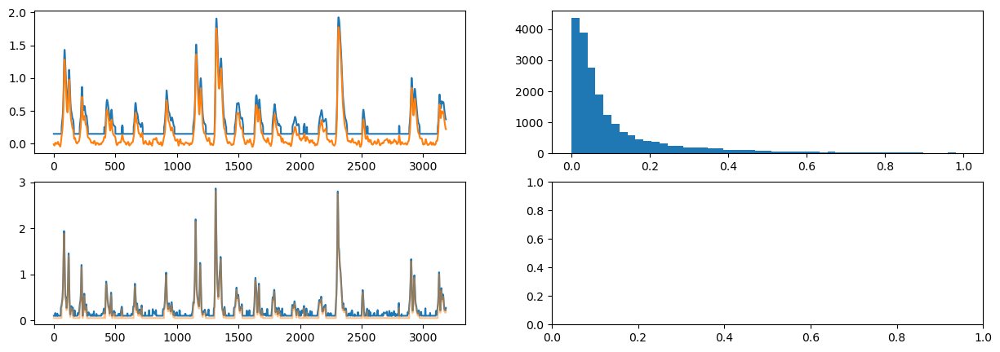

In [43]:
fig, ax = plt.subplots(2,2, figsize = [15,5])
cell = 10
tstart = 6000
tstop = 10000
# ax[0].plot(sess.timeseries['spks'][0,31500:32500]*10)
ax[0,0].plot(dff[cell,tstart:tstop]+.15)
ax[0,0].plot(sess.timeseries['F_dff'][cell,tstart:tstop])
ax[0,1].hist(sess.timeseries['F_dff'][cell,:],np.linspace(0,1,num=50))
# mu, std = np.nanmedian(sess.timeseries['F_dff'][cell,:]), np.nanpercentile(sess.timeseries['F_dff'][cell,:],90)
# ax[0,0].plot(np.arange(tstop-tstart),0*np.arange(tstop-tstart) + mu + std)
# ax[1].plot(sess.timeseries['spks'][0,31500:32500]*10)
# ax[0].plot(spks[0,31500:32500]*10)

ax[1,0].plot(sess.timeseries['spks'][cell,tstart:tstop]*10+.1)
ax[1,0].plot(spks[cell,tstart:tstop]*10+.05, alpha = .5)
# ax[1].plot(dff[1,31500:32500]+.1)
# ax[1].plot(sess.timeseries['spks'][0,31500:32500]*10)
# ax[1].plot(spks[cell,tstart:tstop]*10,alpha=.5)